In [117]:
import pandas as pd
import numpy as np
import plotly.express as px 
import matplotlib.pyplot as plt 
import seaborn as sns
from tqdm import tqdm
import statsmodels.api as sm 
import pmdarima as pm

In [2]:
city_df = pd.read_csv("/Users/jacksonjerman/Desktop/data/week7/City.csv")

In [3]:
city_df

,RegionID,SizeRank,RegionName,RegionType,StateName,State,Metro,CountyName,2000-01-31,2000-02-29,...,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31
0,6181,0,New York,City,NY,NY,New York-Newark-Jersey City,Queens County,255140.0,256969.0,...,725482.0,729953.0,733407.0,737733.0,742810.0,749269.0,755005.0,761760.0,766981.0,771087.0
1,12447,1,Los Angeles,City,CA,CA,Los Angeles-Long Beach-Anaheim,Los Angeles County,244666.0,244907.0,...,975139.0,980279.0,986710.0,992443.0,1002476.0,1020174.0,1041419.0,1060587.0,1063025.0,1063823.0
2,39051,2,Houston,City,TX,TX,Houston-The Woodlands-Sugar Land,Harris County,111569.0,111566.0,...,246521.0,249037.0,251927.0,254957.0,258431.0,262926.0,267755.0,272362.0,275830.0,278057.0
3,17426,3,Chicago,City,IL,IL,Chicago-Naperville-Elgin,Cook County,166868.0,167209.0,...,294443.0,297264.0,299937.0,302603.0,304173.0,306364.0,307938.0,311156.0,313608.0,314966.0
4,6915,4,San Antonio,City,TX,TX,San Antonio-New Braunfels,Bexar County,116430.0,116613.0,...,265053.0,268740.0,273479.0,278278.0,282796.0,288569.0,294292.0,299428.0,302430.0,303510.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22458,51148,29449,Broad Top,City,PA,PA,Huntingdon,Huntingdon County,NaN,NaN,...,140749.0,141229.0,143360.0,144894.0,147661.0,147421.0,147553.0,147180.0,149451.0,151175.0
22459,12973,29449,Newcastle,City,NE,NE,Sioux City,Dixon County,NaN,NaN,...,76541.0,77496.0,79312.0,80380.0,81282.0,81441.0,81626.0,83350.0,85843.0,88446.0
22460,48550,29449,Winton,City,MN,MN,Duluth,Saint Louis County,NaN,NaN,...,98685.0,98724.0,99545.0,100067.0,101868.0,104550.0,108202.0,111805.0,114665.0,116456.0
22461,5133,29449,Hermitage,City,MO,MO,NaN,Hickory County,NaN,NaN,...,130559.0,132632.0,134634.0,136550.0,138558.0,139829.0,141077.0,141888.0,143841.0,146028.0


In [4]:
utcity_df = city_df.loc[city_df['State'] ==  "UT"]

In [5]:
utah_df = utcity_df.drop(columns = ['RegionID', 'SizeRank', 'StateName', 'RegionType', 'State', 'Metro' ])

In [6]:
utah_df

,RegionName,CountyName,2000-01-31,2000-02-29,2000-03-31,2000-04-30,2000-05-31,2000-06-30,2000-07-31,2000-08-31,...,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31
147,Salt Lake City,Salt Lake County,191461.0,191504.0,191724.0,192115.0,194805.0,196727.0,198735.0,198433.0,...,603926.0,607909.0,616112.0,623980.0,639883.0,651936.0,666008.0,675485.0,677344.0,670427.0
248,West Valley City,Salt Lake County,152737.0,152971.0,153343.0,154177.0,156534.0,158543.0,160377.0,160641.0,...,435423.0,438635.0,445690.0,453739.0,466942.0,476645.0,487110.0,494436.0,495612.0,491029.0
309,Provo,Utah County,NaN,NaN,NaN,NaN,186158.0,186234.0,186247.0,186589.0,...,484266.0,489897.0,498203.0,506027.0,515254.0,522142.0,535825.0,544459.0,548019.0,542513.0
343,West Jordan,Salt Lake County,183632.0,183757.0,184193.0,184764.0,187528.0,189678.0,192300.0,192847.0,...,528495.0,534257.0,543847.0,552953.0,567353.0,578227.0,590787.0,600059.0,601978.0,597209.0
407,Sandy,Salt Lake County,211670.0,211691.0,211895.0,212207.0,214892.0,216965.0,219130.0,218939.0,...,637537.0,642477.0,650449.0,658017.0,674819.0,688708.0,705251.0,716774.0,717405.0,708948.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22231,Spanish Valley,San Juan County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,565422.0,570501.0,584654.0,597332.0,608745.0,611747.0,615633.0,619879.0,632212.0,644024.0
22274,Stockton,Tooele County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,310710.0,316227.0,324470.0,330505.0,337187.0,351084.0,363162.0,376821.0,380334.0,386150.0
22280,Eureka,Juab County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,192678.0,200967.0,206560.0,209888.0,210412.0,209809.0,211093.0,214644.0,220201.0,225651.0
22308,Hildale,Washington County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,489155.0,493296.0,487428.0,484804.0,478525.0,475558.0,482260.0,487063.0,506399.0,519644.0


In [7]:
pd.set_option("display.max_columns", 224)
pd.set_option("display.max_rows", 275)

In [8]:
utah_df

,RegionName,CountyName,2000-01-31,2000-02-29,2000-03-31,2000-04-30,2000-05-31,2000-06-30,2000-07-31,2000-08-31,2000-09-30,2000-10-31,2000-11-30,2000-12-31,2001-01-31,2001-02-28,2001-03-31,2001-04-30,2001-05-31,2001-06-30,2001-07-31,2001-08-31,2001-09-30,2001-10-31,2001-11-30,2001-12-31,2002-01-31,2002-02-28,2002-03-31,2002-04-30,2002-05-31,2002-06-30,2002-07-31,2002-08-31,2002-09-30,2002-10-31,2002-11-30,2002-12-31,2003-01-31,2003-02-28,2003-03-31,2003-04-30,2003-05-31,2003-06-30,2003-07-31,2003-08-31,2003-09-30,2003-10-31,2003-11-30,2003-12-31,2004-01-31,2004-02-29,2004-03-31,2004-04-30,2004-05-31,2004-06-30,2004-07-31,2004-08-31,2004-09-30,2004-10-31,2004-11-30,2004-12-31,2005-01-31,2005-02-28,2005-03-31,2005-04-30,2005-05-31,2005-06-30,2005-07-31,2005-08-31,2005-09-30,2005-10-31,2005-11-30,2005-12-31,2006-01-31,2006-02-28,2006-03-31,2006-04-30,2006-05-31,2006-06-30,2006-07-31,2006-08-31,2006-09-30,2006-10-31,2006-11-30,2006-12-31,2007-01-31,2007-02-28,2007-03-31,2007-04-30,2007-05-31,2007-06-30,2007-07-31,2007-08-31,2007-09-30,2007-10-31,2007-11-30,2007-12-31,2008-01-31,2008-02-29,2008-03-31,2008-04-30,2008-05-31,2008-06-30,2008-07-31,2008-08-31,2008-09-30,2008-10-31,2008-11-30,2008-12-31,2009-01-31,2009-02-28,...,2013-04-30,2013-05-31,2013-06-30,2013-07-31,2013-08-31,2013-09-30,2013-10-31,2013-11-30,2013-12-31,2014-01-31,2014-02-28,2014-03-31,2014-04-30,2014-05-31,2014-06-30,2014-07-31,2014-08-31,2014-09-30,2014-10-31,2014-11-30,2014-12-31,2015-01-31,2015-02-28,2015-03-31,2015-04-30,2015-05-31,2015-06-30,2015-07-31,2015-08-31,2015-09-30,2015-10-31,2015-11-30,2015-12-31,2016-01-31,2016-02-29,2016-03-31,2016-04-30,2016-05-31,2016-06-30,2016-07-31,2016-08-31,2016-09-30,2016-10-31,2016-11-30,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28,2021-03-31,2021-04-30,2021-05-31,2021-06-30,2021-07-31,2021-08-31,2021-09-30,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31
147,Salt Lake City,Salt Lake County,191461.0,191504.0,191724.0,192115.0,194805.0,196727.0,198735.0,198433.0,198839.0,199023.0,199409.0,199677.0,199802.0,199875.0,200055.0,200441.0,200537.0,200689.0,200643.0,201008.0,201302.0,201714.0,202050.0,202271.0,202521.0,202280.0,202425.0,202771.0,203105.0,203230.0,203233.0,203096.0,202902.0,202469.0,202529.0,202449.0,202386.0,202665.0,202890.0,203279.0,203428.0,203848.0,204457.0,204926.0,205221.0,205135.0,205171.0,205221.0,205384.0,205657.0,205849.0,206244.0,206622.0,207304.0,207740.0,208076.0,208228.0,208548.0,208930.0,209137.0,208982.0,209282.0,209885.0,211320.0,212109.0,213207.0,214339.0,215711.0,217012.0,218518.0,220789.0,223433.0,225366.0,227070.0,228603.0,231039.0,234219.0,238212.0,243342.0,248735.0,253655.0,258240.0,261999.0,265731.0,269279.0,272623.0,275903.0,278191.0,281023.0,284974.0,289109.0,293010.0,294979.0,296101.0,297072.0,298130.0,299000.0,298457.0,296562.0,293849.0,291255.0,288465.0,285493.0,282249.0,280372.0,278739.0,277336.0,275361.0,271492.0,267114.0,...,257926.0,261088.0,264474.0,266809.0,270368.0,273188.0,276246.0,278148.0,279275.0,280835.0,281968.0,284080.0,283637.0,283861.0,283136.0,283055.0,283540.0,284035.0,285156.0,286209.0,286352.0,287036.0,287544.0,289739.0,292510.0,295175.0,297489.0,299911.0,303092.0,306491.0,309187.0,311222.0,313394.0,315145.0,316323.0,317090.0,318716.0,321486.0,324078.0,327467.0,329045.0,331232.0,332363.0,335656.0,339527.0,342794.0,345323.0,347535.0,350726.0,353591.0,357354.0,360986.0,365696.0,368564.0,371008.0,372236

In [9]:
utah_df = utah_df.drop(columns = ['2000-01-31', '2000-02-29', '2000-03-31', '2000-04-30'])

In [10]:
utah_df = utah_df.dropna()

In [11]:
utah_df

,RegionName,CountyName,2000-05-31,2000-06-30,2000-07-31,2000-08-31,2000-09-30,2000-10-31,2000-11-30,2000-12-31,2001-01-31,2001-02-28,2001-03-31,2001-04-30,2001-05-31,2001-06-30,2001-07-31,2001-08-31,2001-09-30,2001-10-31,2001-11-30,2001-12-31,2002-01-31,2002-02-28,2002-03-31,2002-04-30,2002-05-31,2002-06-30,2002-07-31,2002-08-31,2002-09-30,2002-10-31,2002-11-30,2002-12-31,2003-01-31,2003-02-28,2003-03-31,2003-04-30,2003-05-31,2003-06-30,2003-07-31,2003-08-31,2003-09-30,2003-10-31,2003-11-30,2003-12-31,2004-01-31,2004-02-29,2004-03-31,2004-04-30,2004-05-31,2004-06-30,2004-07-31,2004-08-31,2004-09-30,2004-10-31,2004-11-30,2004-12-31,2005-01-31,2005-02-28,2005-03-31,2005-04-30,2005-05-31,2005-06-30,2005-07-31,2005-08-31,2005-09-30,2005-10-31,2005-11-30,2005-12-31,2006-01-31,2006-02-28,2006-03-31,2006-04-30,2006-05-31,2006-06-30,2006-07-31,2006-08-31,2006-09-30,2006-10-31,2006-11-30,2006-12-31,2007-01-31,2007-02-28,2007-03-31,2007-04-30,2007-05-31,2007-06-30,2007-07-31,2007-08-31,2007-09-30,2007-10-31,2007-11-30,2007-12-31,2008-01-31,2008-02-29,2008-03-31,2008-04-30,2008-05-31,2008-06-30,2008-07-31,2008-08-31,2008-09-30,2008-10-31,2008-11-30,2008-12-31,2009-01-31,2009-02-28,2009-03-31,2009-04-30,2009-05-31,2009-06-30,...,2013-04-30,2013-05-31,2013-06-30,2013-07-31,2013-08-31,2013-09-30,2013-10-31,2013-11-30,2013-12-31,2014-01-31,2014-02-28,2014-03-31,2014-04-30,2014-05-31,2014-06-30,2014-07-31,2014-08-31,2014-09-30,2014-10-31,2014-11-30,2014-12-31,2015-01-31,2015-02-28,2015-03-31,2015-04-30,2015-05-31,2015-06-30,2015-07-31,2015-08-31,2015-09-30,2015-10-31,2015-11-30,2015-12-31,2016-01-31,2016-02-29,2016-03-31,2016-04-30,2016-05-31,2016-06-30,2016-07-31,2016-08-31,2016-09-30,2016-10-31,2016-11-30,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28,2021-03-31,2021-04-30,2021-05-31,2021-06-30,2021-07-31,2021-08-31,2021-09-30,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31
147,Salt Lake City,Salt Lake County,194805.0,196727.0,198735.0,198433.0,198839.0,199023.0,199409.0,199677.0,199802.0,199875.0,200055.0,200441.0,200537.0,200689.0,200643.0,201008.0,201302.0,201714.0,202050.0,202271.0,202521.0,202280.0,202425.0,202771.0,203105.0,203230.0,203233.0,203096.0,202902.0,202469.0,202529.0,202449.0,202386.0,202665.0,202890.0,203279.0,203428.0,203848.0,204457.0,204926.0,205221.0,205135.0,205171.0,205221.0,205384.0,205657.0,205849.0,206244.0,206622.0,207304.0,207740.0,208076.0,208228.0,208548.0,208930.0,209137.0,208982.0,209282.0,209885.0,211320.0,212109.0,213207.0,214339.0,215711.0,217012.0,218518.0,220789.0,223433.0,225366.0,227070.0,228603.0,231039.0,234219.0,238212.0,243342.0,248735.0,253655.0,258240.0,261999.0,265731.0,269279.0,272623.0,275903.0,278191.0,281023.0,284974.0,289109.0,293010.0,294979.0,296101.0,297072.0,298130.0,299000.0,298457.0,296562.0,293849.0,291255.0,288465.0,285493.0,282249.0,280372.0,278739.0,277336.0,275361.0,271492.0,267114.0,262580.0,260536.0,258645.0,257402.0,...,257926.0,261088.0,264474.0,266809.0,270368.0,273188.0,276246.0,278148.0,279275.0,280835.0,281968.0,284080.0,283637.0,283861.0,283136.0,283055.0,283540.0,284035.0,285156.0,286209.0,286352.0,287036.0,287544.0,289739.0,292510.0,295175.0,297489.0,299911.0,303092.0,306491.0,309187.0,311222.0,313394.0,315145.0,316323.0,317090.0,318716.0,321486.0,324078.0,327467.0,329045.0,331232.0,332363.0,335656.0,339527.0,342794.0,345323.0,347535.0,350726.0,353591.0,357354.0,360986.0,365696.0,368564.0,371008.0,372236

In [12]:
newUtah_df = utah_df.transpose()

In [13]:
newUtah_df

,147,248,309,343,407,452,685,813,839,1118,1119,1196,1379,1471,1541,1669,1741,1791,1828,1923,2039,2057,2058,2132,2206,2402,2603,3170,3257,3279,3282,3468,3477,3945,4443,4628,4857,5044,5105,5378,5441,5821,5845,5987,6853,6983,7267,7472,7663,8423,8439,8623,8633,9412,9557,9992,10335,13687,15904,17252,18175
RegionName,Salt Lake City,West Valley City,Provo,West Jordan,Sandy,Orem,Layton,South Jordan,Taylorsville,Draper,Murray,Bountiful,Riverton,Roy,Kearns,Cottonwood Heights,Midvale,Millcreek,American Fork,Springville,Clearfield,Magna,Holladay,Kaysville,South Salt Lake,Herriman,Syracuse,North Ogden,Saratoga Springs,Centerville,Highland,North Salt Lake,Payson,Farmington,West Haven,Lindon,Alpine,Bluffdale,Hooper,Woods Cross,Mapleton,Pleasant View,West Point,Riverdale,Farr West,Salem,Harrisville,Santaquin,Sunset,Mount Olympus,White City,Plain City,West Bountiful,Fruit Heights,Marriott-Slaterville City,Huntsville,Eden,Bingham Canyon,Granite,Uintah,Elk Ridge
CountyName,Salt Lake County,Salt Lake County,Utah County,Salt Lake County,Salt Lake County,Utah County,Davis County,Salt Lake County,Salt Lake County,Salt Lake County,Salt Lake County,Davis County,Salt Lake County,Weber County,Salt Lake County,Salt Lake County,Salt Lake County,Salt Lake County,Utah County,Utah County,Davis County,Salt Lake County,Salt Lake County,Davis County,Salt Lake County,Salt Lake County,Davis County,Weber County,Utah County,Davis County,Utah County,Davis County,Utah County,Davis County,Weber County,Utah County,Utah County,Salt Lake County,Weber County,Davis County,Utah County,Weber County,Davis County,Weber County,Weber County,Utah County,Weber County,Utah County,Davis County,Salt Lake County,Salt Lake County,Weber County,Davis County,Davis County,Weber County,Weber County,Weber County,Salt Lake County,Salt Lake County,Weber County,Utah County
2000-05-31,194805.0,156534.0,186158.0,187528.0,214892.0,186971.0,173207.0,262102.0,167938.0,315838.0,199717.0,207448.0,223983.0,137758.0,134124.0,260443.0,168055.0,221019.0,196929.0,190923.0,134772.0,139246.0,307636.0,222695.0,158060.0,236464.0,194627.0,186520.0,225571.0,197608.0,336722.0,215204.0,158579.0,235020.0,225750.0,276449.0,390310.0,254617.0,226077.0,171497.0,302436.0,245337.0,181483.0,160754.0,215940.0,232355.0,162942.0,170728.0,109125.0,384660.0,160768.0,206867.0,187907.0,233859.0,220838.0,290323.0,311814.0,147399.0,401497.0,199380.0,251761.0
2000-06-30,196727.0,158543.0,186234.0,189678.0,216965.0,186253.0,173929.0,264366.0,170035.0,319925.0,201452.0,209076.0,225701.0,139683.0,136128.0,262819.0,169914.0,222973.0,196563.0,190990.0,135864.0,141661.0,311075.0,223764.0,159641.0,238799.0,195300.0,187682.0,225832.0,198234.0,336864.0,214919.0,158795.0,235055.0,227774.0,277122.0,390242.0,256955.0,227500.0,171572.0,304126.0,247656.0,182167.0,162306.0,217669.0,231508.0,163584.0,170587.0,110121.0,391320.0,162495.0,208582.0,188299.0,233270.0,222137.0,291094.0,311952.0,150029.0,408316.0,200575.0,255526.0
2000-07-31,198735.0,160377.0,186247.0,192300.0,219130.0,185832.0,174659.0,267787.0,172059.0,324988.0,203359.0,210304.0,228495.0,141660.0,137760.0,264592.0,171841.0,224659.0,196561.0,190971.0,136796.0,143560.0,314092.0,224616.0,161369.0,241299.0,196196.0,188447.0,225671.0,198970.0,335825.0,215126.0,158848.0,235351.0,228794.0,276195.0,389085.0,260381.0,228526.0,171512.0,303194.0,248632.0,182972.0,163080.0,218209.0,230812.0,163873.0,170344.0,110770.0,397319.0,164098.0,209595.0,189012.0,233356.0,221783.0,293495.0,311166.0,153104.0,414027.0,202534.0,258110.0
2000-08-31,198433.0,160641.0,186589.0,192847.0,218939.0,185427.0,175048.0,269102.0,172105.0,327064.0,202522.0,210865.0,229122.0,143122.0,137933.0,264301.0,171636.0,223792.0,197104.0,191194.0,137129.0,143836.0,312929.0,225368.0,161452.0,241767.0,196371.0,189291.0,225403.0,199543.0,334856.0,215651.0,159141.0,235852.0,230552.0,275195.0,387978.0,263376.0,229508.0,171394.0,302325.0,249995.0,183593.0,163754.0,219020.0,230094.0,164552.0,170244.0,111296.0,395215.0,164022.0,211309.0,1893

In [14]:
newColumns_df = newUtah_df.iloc[0]

In [15]:
newUtah_df.columns = newColumns_df

In [16]:
newUtah_df = newUtah_df.iloc[2:268]

In [17]:
newUtah_df = newUtah_df.reset_index()

In [18]:
newUtah_df = newUtah_df.rename(columns = {'index': 'Date'})

In [19]:
newUtah_df

RegionName,Date,Salt Lake City,West Valley City,Provo,West Jordan,Sandy,Orem,Layton,South Jordan,Taylorsville,Draper,Murray,Bountiful,Riverton,Roy,Kearns,Cottonwood Heights,Midvale,Millcreek,American Fork,Springville,Clearfield,Magna,Holladay,Kaysville,South Salt Lake,Herriman,Syracuse,North Ogden,Saratoga Springs,Centerville,Highland,North Salt Lake,Payson,Farmington,West Haven,Lindon,Alpine,Bluffdale,Hooper,Woods Cross,Mapleton,Pleasant View,West Point,Riverdale,Farr West,Salem,Harrisville,Santaquin,Sunset,Mount Olympus,White City,Plain City,West Bountiful,Fruit Heights,Marriott-Slaterville City,Huntsville,Eden,Bingham Canyon,Granite,Uintah,Elk Ridge
0,2000-05-31,194805.0,156534.0,186158.0,187528.0,214892.0,186971.0,173207.0,262102.0,167938.0,315838.0,199717.0,207448.0,223983.0,137758.0,134124.0,260443.0,168055.0,221019.0,196929.0,190923.0,134772.0,139246.0,307636.0,222695.0,158060.0,236464.0,194627.0,186520.0,225571.0,197608.0,336722.0,215204.0,158579.0,235020.0,225750.0,276449.0,390310.0,254617.0,226077.0,171497.0,302436.0,245337.0,181483.0,160754.0,215940.0,232355.0,162942.0,170728.0,109125.0,384660.0,160768.0,206867.0,187907.0,233859.0,220838.0,290323.0,311814.0,147399.0,401497.0,199380.0,251761.0
1,2000-06-30,196727.0,158543.0,186234.0,189678.0,216965.0,186253.0,173929.0,264366.0,170035.0,319925.0,201452.0,209076.0,225701.0,139683.0,136128.0,262819.0,169914.0,222973.0,196563.0,190990.0,135864.0,141661.0,311075.0,223764.0,159641.0,238799.0,195300.0,187682.0,225832.0,198234.0,336864.0,214919.0,158795.0,235055.0,227774.0,277122.0,390242.0,256955.0,227500.0,171572.0,304126.0,247656.0,182167.0,162306.0,217669.0,231508.0,163584.0,170587.0,110121.0,391320.0,162495.0,208582.0,188299.0,233270.0,222137.0,291094.0,311952.0,150029.0,408316.0,200575.0,255526.0
2,2000-07-31,198735.0,160377.0,186247.0,192300.0,219130.0,185832.0,174659.0,267787.0,172059.0,324988.0,203359.0,210304.0,228495.0,141660.0,137760.0,264592.0,171841.0,224659.0,196561.0,190971.0,136796.0,143560.0,314092.0,224616.0,161369.0,241299.0,196196.0,188447.0,225671.0,198970.0,335825.0,215126.0,158848.0,235351.0,228794.0,276195.0,389085.0,260381.0,228526.0,171512.0,303194.0,248632.0,182972.0,163080.0,218209.0,230812.0,163873.0,170344.0,110770.0,397319.0,164098.0,209595.0,189012.0,233356.0,221783.0,293495.0,311166.0,153104.0,414027.0,202534.0,258110.0
3,2000-08-31,198433.0,160641.0,186589.0,192847.0,218939.0,185427.0,175048.0,269102.0,172105.0,327064.0,202522.0,210865.0,229122.0,143122.0,137933.0,264301.0,171636.0,223792.0,197104.0,191194.0,137129.0,143836.0,312929.0,225368.0,161452.0,241767.0,196371.0,189291.0,225403.0,199543.0,334856.0,215651.0,159141.0,235852.0,230552.0,275195.0,387978.0,263376.0,229508.0,171394.0,302325.0,249995.0,183593.0,163754.0,219020.0,230094.0,164552.0,170244.0,111296.0,395215.0,164022.0,211309.0,189333.0,234058.0,221539.0,294643.0,311336.0,154141.0,412372.0,205587.0,261565.0
4,2000-09-30,198839.0,161187.0,187335.0,193715.0,219095.0,185899.0,175651.0,269375.0,172570.0,327991.0,202137.0,211034.0,229397.0,144257.0,138145.0,264286.0,172009.0,223493.0,198584.0,191658.0,137224.0,144473.0,312385.0,226216.0,161678.0,242097.0,196369.0,189570.0,225660.0,200264.0,333578.0,216991.0,159654.0,236733.0,230961.0,274273.0,388841.0,265670.0,230601.0,171694.0,299091.0,250386.0,184145.0,164423.0,219046.0,230195.0,165264.0,170325.0,111714.0,393732.0,163910.0,211152.0,189793.0,235070.0,221271.0,294835.0,310988.0,154162.0,411115.0,210269.0,263441.0
5,2000-10-31,199023.0,161547.0,188341.0,194112.0,219153.0,186778.0,176146.0,268818.0,172942.0,329028.0,201422.0,211666.0,229009.0,145019.0,138374.0,264187.0,172104.0,223324.0,200476.0,192582.0,137658.0,145362.0,312374.0,227450.0,161629.0,241435.0,196161.0,189528.0,226456.0,201276.0,333767.0,218398.0,160221.0,237841.0,231529.0,274720.0,391776.0,268146.0,231968.0,172669.0,296817.0,251324.0,184484.0,165293.0,219794.0,231222.0,166770.0,171268.0,112734.0,392859.0,163577.0,212082.0,190298.0,235870.0,222172.0,295502.0,310981.0,153

In [20]:
newUtah_df.isnull().sum()

RegionName
Date                         0
Salt Lake City               0
West Valley City             0
Provo                        0
West Jordan                  0
Sandy                        0
Orem                         0
Layton                       0
South Jordan                 0
Taylorsville                 0
Draper                       0
Murray                       0
Bountiful                    0
Riverton                     0
Roy                          0
Kearns                       0
Cottonwood Heights           0
Midvale                      0
Millcreek                    0
American Fork                0
Springville                  0
Clearfield                   0
Magna                        0
Holladay                     0
Kaysville                    0
South Salt Lake              0
Herriman                     0
Syracuse                     0
North Ogden                  0
Saratoga Springs             0
Centerville                  0
Highland                    

In [21]:
interest_df = pd.read_csv("/Users/jacksonjerman/Desktop/data/week7/interestRates.csv", encoding_errors = "ignore")

In [22]:
interest_df 

,Date,Rate
0,2000-05-31,8.52
1,2000-06-30,8.29
2,2000-07-31,8.15
3,2000-08-31,8.03
4,2000-09-30,7.91
5,2000-10-31,7.80
6,2000-11-30,7.75
7,2000-12-31,7.38
8,2001-01-31,7.03
9,2001-02-28,7.05


In [23]:
main_df = newUtah_df.merge(interest_df, how = 'outer', on = 'Date')

In [24]:
main_df

,Date,Salt Lake City,West Valley City,Provo,West Jordan,Sandy,Orem,Layton,South Jordan,Taylorsville,Draper,Murray,Bountiful,Riverton,Roy,Kearns,Cottonwood Heights,Midvale,Millcreek,American Fork,Springville,Clearfield,Magna,Holladay,Kaysville,South Salt Lake,Herriman,Syracuse,North Ogden,Saratoga Springs,Centerville,Highland,North Salt Lake,Payson,Farmington,West Haven,Lindon,Alpine,Bluffdale,Hooper,Woods Cross,Mapleton,Pleasant View,West Point,Riverdale,Farr West,Salem,Harrisville,Santaquin,Sunset,Mount Olympus,White City,Plain City,West Bountiful,Fruit Heights,Marriott-Slaterville City,Huntsville,Eden,Bingham Canyon,Granite,Uintah,Elk Ridge,Rate
0,2000-05-31,194805.0,156534.0,186158.0,187528.0,214892.0,186971.0,173207.0,262102.0,167938.0,315838.0,199717.0,207448.0,223983.0,137758.0,134124.0,260443.0,168055.0,221019.0,196929.0,190923.0,134772.0,139246.0,307636.0,222695.0,158060.0,236464.0,194627.0,186520.0,225571.0,197608.0,336722.0,215204.0,158579.0,235020.0,225750.0,276449.0,390310.0,254617.0,226077.0,171497.0,302436.0,245337.0,181483.0,160754.0,215940.0,232355.0,162942.0,170728.0,109125.0,384660.0,160768.0,206867.0,187907.0,233859.0,220838.0,290323.0,311814.0,147399.0,401497.0,199380.0,251761.0,8.52
1,2000-06-30,196727.0,158543.0,186234.0,189678.0,216965.0,186253.0,173929.0,264366.0,170035.0,319925.0,201452.0,209076.0,225701.0,139683.0,136128.0,262819.0,169914.0,222973.0,196563.0,190990.0,135864.0,141661.0,311075.0,223764.0,159641.0,238799.0,195300.0,187682.0,225832.0,198234.0,336864.0,214919.0,158795.0,235055.0,227774.0,277122.0,390242.0,256955.0,227500.0,171572.0,304126.0,247656.0,182167.0,162306.0,217669.0,231508.0,163584.0,170587.0,110121.0,391320.0,162495.0,208582.0,188299.0,233270.0,222137.0,291094.0,311952.0,150029.0,408316.0,200575.0,255526.0,8.29
2,2000-07-31,198735.0,160377.0,186247.0,192300.0,219130.0,185832.0,174659.0,267787.0,172059.0,324988.0,203359.0,210304.0,228495.0,141660.0,137760.0,264592.0,171841.0,224659.0,196561.0,190971.0,136796.0,143560.0,314092.0,224616.0,161369.0,241299.0,196196.0,188447.0,225671.0,198970.0,335825.0,215126.0,158848.0,235351.0,228794.0,276195.0,389085.0,260381.0,228526.0,171512.0,303194.0,248632.0,182972.0,163080.0,218209.0,230812.0,163873.0,170344.0,110770.0,397319.0,164098.0,209595.0,189012.0,233356.0,221783.0,293495.0,311166.0,153104.0,414027.0,202534.0,258110.0,8.15
3,2000-08-31,198433.0,160641.0,186589.0,192847.0,218939.0,185427.0,175048.0,269102.0,172105.0,327064.0,202522.0,210865.0,229122.0,143122.0,137933.0,264301.0,171636.0,223792.0,197104.0,191194.0,137129.0,143836.0,312929.0,225368.0,161452.0,241767.0,196371.0,189291.0,225403.0,199543.0,334856.0,215651.0,159141.0,235852.0,230552.0,275195.0,387978.0,263376.0,229508.0,171394.0,302325.0,249995.0,183593.0,163754.0,219020.0,230094.0,164552.0,170244.0,111296.0,395215.0,164022.0,211309.0,189333.0,234058.0,221539.0,294643.0,311336.0,154141.0,412372.0,205587.0,261565.0,8.03
4,2000-09-30,198839.0,161187.0,187335.0,193715.0,219095.0,185899.0,175651.0,269375.0,172570.0,327991.0,202137.0,211034.0,229397.0,144257.0,138145.0,264286.0,172009.0,223493.0,198584.0,191658.0,137224.0,144473.0,312385.0,226216.0,161678.0,242097.0,196369.0,189570.0,225660.0,200264.0,333578.0,216991.0,159654.0,236733.0,230961.0,274273.0,388841.0,265670.0,230601.0,171694.0,299091.0,250386.0,184145.0,164423.0,219046.0,230195.0,165264.0,170325.0,111714.0,393732.0,163910.0,211152.0,189793.0,235070.0,221271.0,294835.0,310988.0,154162.0,411115.0,210269.0,263441.0,7.91
5,2000-10-31,199023.0,161547.0,188341.0,194112.0,219153.0,186778.0,176146.0,268818.0,172942.0,329028.0,201422.0,211666.0,229009.0,145019.0,138374.0,264187.0,172104.0,223324.0,200476.0,192582.0,137658.0,145362.0,312374.0,227450.0,161629.0,241435.0,196161.0,189528.0,226456.0,201276.0,333767.0,218398.0,160221.0,237841.0,231529.0,274720.0,391776.0,268146.0,231968.0,172669.0,296817.0,251324.0,184484.0,165293.0,219794.0,231222.0,166770.0,171268.0,112734.0,392859.0,163577.0,212082.0,190298.0,235870.0,222172.0,2

In [25]:
main_df.insert(1, "Rate ", main_df.pop("Rate "))

In [26]:
main_df = main_df.iloc[0:265, :]

In [27]:
main_df

,Date,Rate,Salt Lake City,West Valley City,Provo,West Jordan,Sandy,Orem,Layton,South Jordan,Taylorsville,Draper,Murray,Bountiful,Riverton,Roy,Kearns,Cottonwood Heights,Midvale,Millcreek,American Fork,Springville,Clearfield,Magna,Holladay,Kaysville,South Salt Lake,Herriman,Syracuse,North Ogden,Saratoga Springs,Centerville,Highland,North Salt Lake,Payson,Farmington,West Haven,Lindon,Alpine,Bluffdale,Hooper,Woods Cross,Mapleton,Pleasant View,West Point,Riverdale,Farr West,Salem,Harrisville,Santaquin,Sunset,Mount Olympus,White City,Plain City,West Bountiful,Fruit Heights,Marriott-Slaterville City,Huntsville,Eden,Bingham Canyon,Granite,Uintah,Elk Ridge
0,2000-05-31,8.52,194805.0,156534.0,186158.0,187528.0,214892.0,186971.0,173207.0,262102.0,167938.0,315838.0,199717.0,207448.0,223983.0,137758.0,134124.0,260443.0,168055.0,221019.0,196929.0,190923.0,134772.0,139246.0,307636.0,222695.0,158060.0,236464.0,194627.0,186520.0,225571.0,197608.0,336722.0,215204.0,158579.0,235020.0,225750.0,276449.0,390310.0,254617.0,226077.0,171497.0,302436.0,245337.0,181483.0,160754.0,215940.0,232355.0,162942.0,170728.0,109125.0,384660.0,160768.0,206867.0,187907.0,233859.0,220838.0,290323.0,311814.0,147399.0,401497.0,199380.0,251761.0
1,2000-06-30,8.29,196727.0,158543.0,186234.0,189678.0,216965.0,186253.0,173929.0,264366.0,170035.0,319925.0,201452.0,209076.0,225701.0,139683.0,136128.0,262819.0,169914.0,222973.0,196563.0,190990.0,135864.0,141661.0,311075.0,223764.0,159641.0,238799.0,195300.0,187682.0,225832.0,198234.0,336864.0,214919.0,158795.0,235055.0,227774.0,277122.0,390242.0,256955.0,227500.0,171572.0,304126.0,247656.0,182167.0,162306.0,217669.0,231508.0,163584.0,170587.0,110121.0,391320.0,162495.0,208582.0,188299.0,233270.0,222137.0,291094.0,311952.0,150029.0,408316.0,200575.0,255526.0
2,2000-07-31,8.15,198735.0,160377.0,186247.0,192300.0,219130.0,185832.0,174659.0,267787.0,172059.0,324988.0,203359.0,210304.0,228495.0,141660.0,137760.0,264592.0,171841.0,224659.0,196561.0,190971.0,136796.0,143560.0,314092.0,224616.0,161369.0,241299.0,196196.0,188447.0,225671.0,198970.0,335825.0,215126.0,158848.0,235351.0,228794.0,276195.0,389085.0,260381.0,228526.0,171512.0,303194.0,248632.0,182972.0,163080.0,218209.0,230812.0,163873.0,170344.0,110770.0,397319.0,164098.0,209595.0,189012.0,233356.0,221783.0,293495.0,311166.0,153104.0,414027.0,202534.0,258110.0
3,2000-08-31,8.03,198433.0,160641.0,186589.0,192847.0,218939.0,185427.0,175048.0,269102.0,172105.0,327064.0,202522.0,210865.0,229122.0,143122.0,137933.0,264301.0,171636.0,223792.0,197104.0,191194.0,137129.0,143836.0,312929.0,225368.0,161452.0,241767.0,196371.0,189291.0,225403.0,199543.0,334856.0,215651.0,159141.0,235852.0,230552.0,275195.0,387978.0,263376.0,229508.0,171394.0,302325.0,249995.0,183593.0,163754.0,219020.0,230094.0,164552.0,170244.0,111296.0,395215.0,164022.0,211309.0,189333.0,234058.0,221539.0,294643.0,311336.0,154141.0,412372.0,205587.0,261565.0
4,2000-09-30,7.91,198839.0,161187.0,187335.0,193715.0,219095.0,185899.0,175651.0,269375.0,172570.0,327991.0,202137.0,211034.0,229397.0,144257.0,138145.0,264286.0,172009.0,223493.0,198584.0,191658.0,137224.0,144473.0,312385.0,226216.0,161678.0,242097.0,196369.0,189570.0,225660.0,200264.0,333578.0,216991.0,159654.0,236733.0,230961.0,274273.0,388841.0,265670.0,230601.0,171694.0,299091.0,250386.0,184145.0,164423.0,219046.0,230195.0,165264.0,170325.0,111714.0,393732.0,163910.0,211152.0,189793.0,235070.0,221271.0,294835.0,310988.0,154162.0,411115.0,210269.0,263441.0
5,2000-10-31,7.80,199023.0,161547.0,188341.0,194112.0,219153.0,186778.0,176146.0,268818.0,172942.0,329028.0,201422.0,211666.0,229009.0,145019.0,138374.0,264187.0,172104.0,223324.0,200476.0,192582.0,137658.0,145362.0,312374.0,227450.0,161629.0,241435.0,196161.0,189528.0,226456.0,201276.0,333767.0,218398.0,160221.0,237841.0,231529.0,274720.0,391776.0,268146.0,231968.0,172669.0,296817.0,251324.0,184484.0,165293.0,219794.0,231222.0,166770.0,171268.0,112734.0,392859.0,163577.0,212082.0,190298.0,235870.0,22217

In [28]:
ids = ["Date", "Rate "]

In [29]:
values = set(main_df.columns.tolist()) - set(ids)

In [30]:
melted_df = pd.melt(main_df, id_vars = ids, value_vars = values)

In [31]:
melted_df

,Date,Rate,variable,value
0,2000-05-31,8.52,West Valley City,156534.0
1,2000-06-30,8.29,West Valley City,158543.0
2,2000-07-31,8.15,West Valley City,160377.0
3,2000-08-31,8.03,West Valley City,160641.0
4,2000-09-30,7.91,West Valley City,161187.0
...,...,...,...,...
16160,2022-01-31,3.45,Springville,505428.0
16161,2022-02-28,3.76,Springville,514827.0
16162,2022-03-31,4.17,Springville,522646.0
16163,2022-04-30,4.98,Springville,537470.0


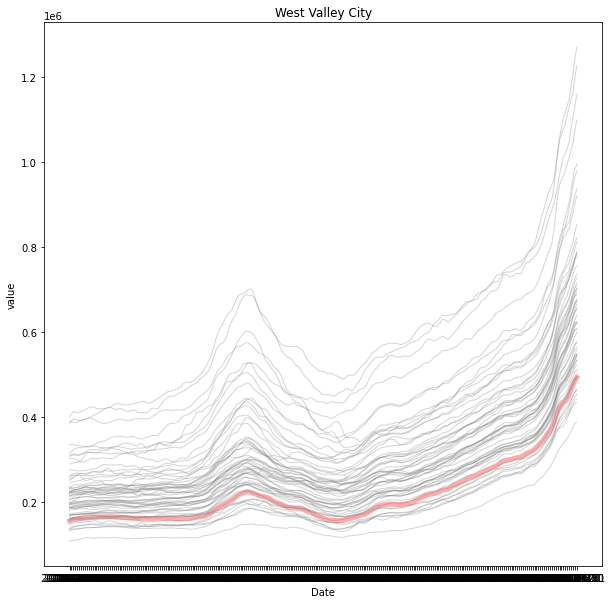

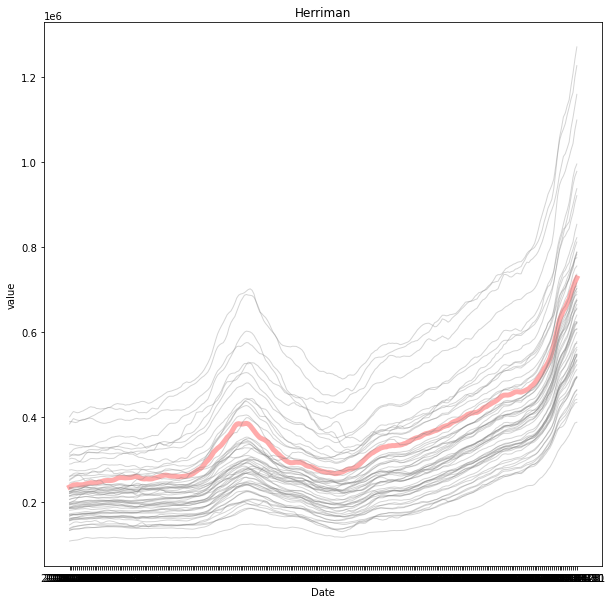

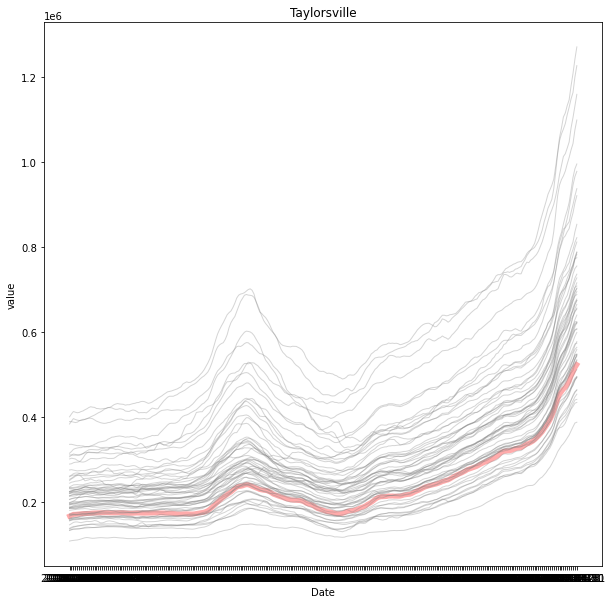

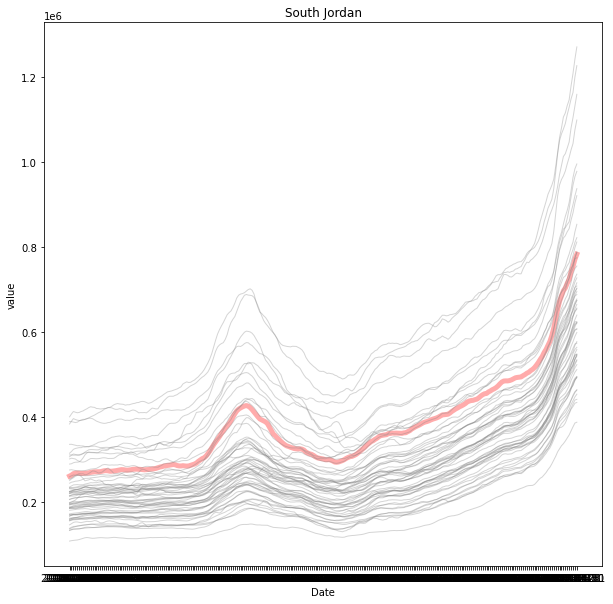

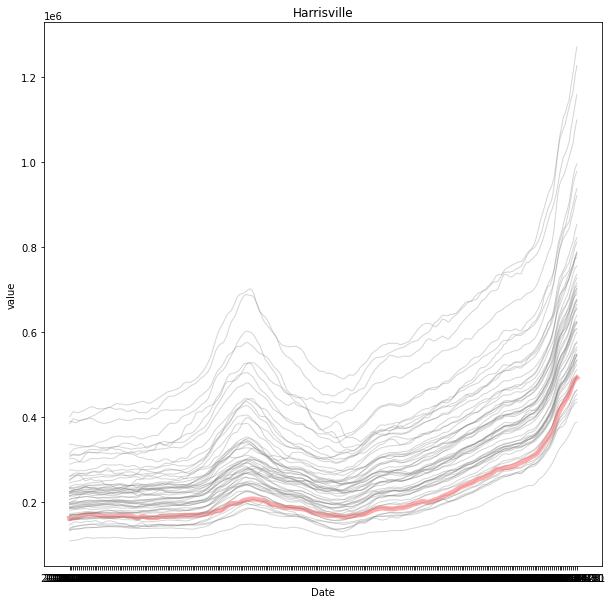

...

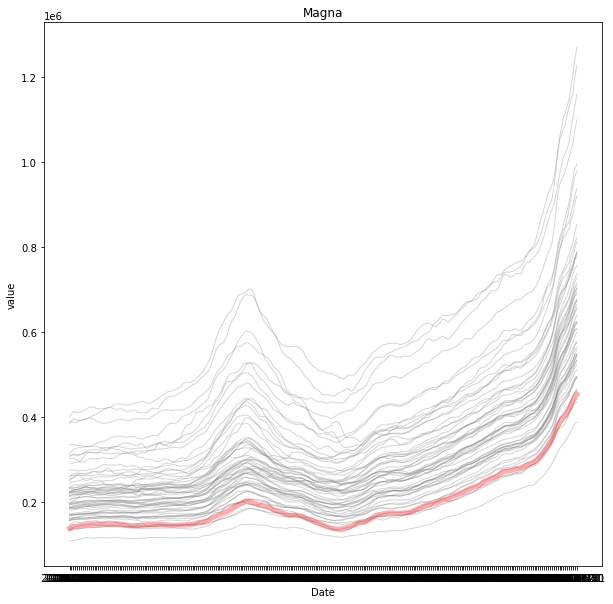

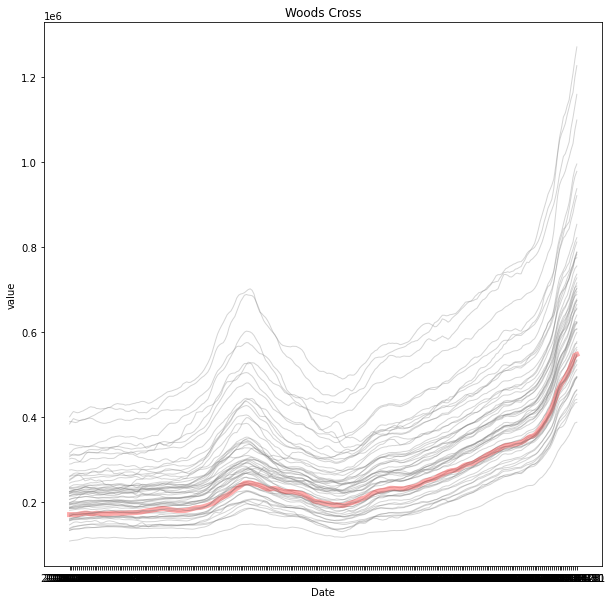

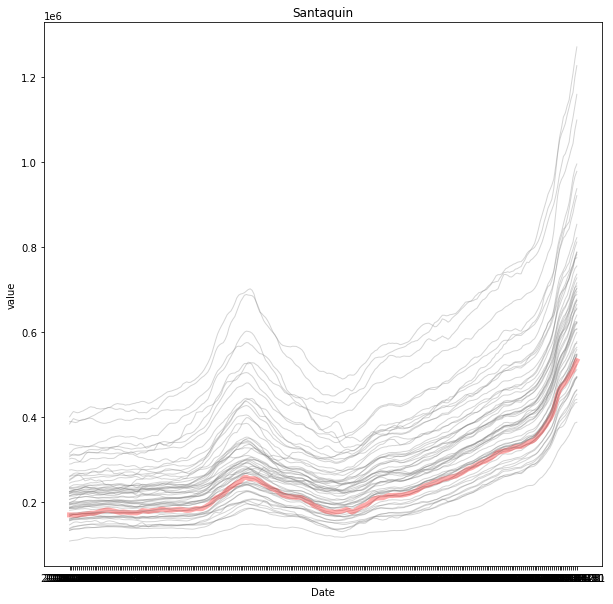

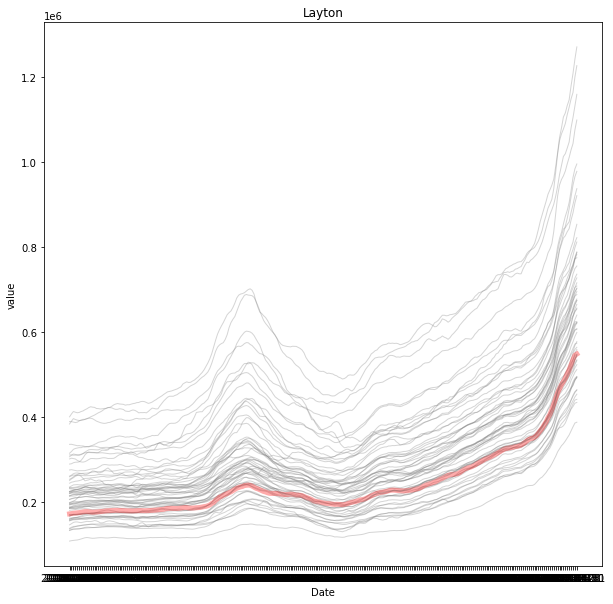

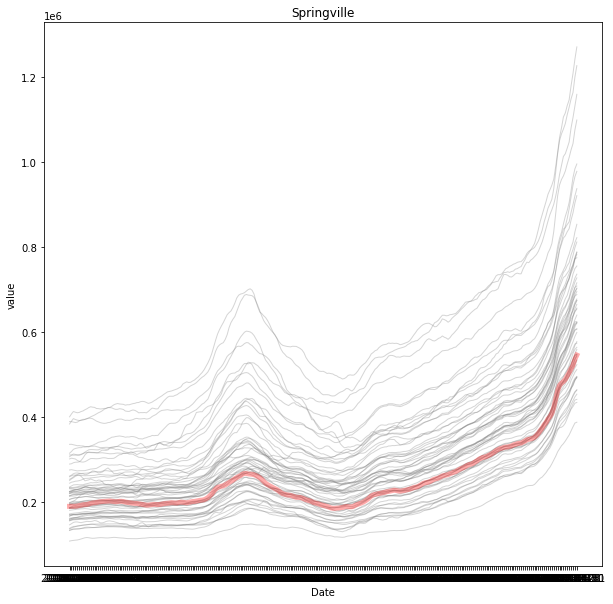

In [32]:
for city in melted_df.variable.unique():
    palette = {c:'red' if c==city else 'grey' for c in melted_df.variable.unique()}
    sizes = {c: 5 if c==city else 1 for c in melted_df.variable.unique()}
    plt.figure(figsize=(10,10))
    ax = sns.lineplot(data = melted_df, x = "Date", y = "value", hue = "variable", alpha = 0.33, palette = palette, size = "variable", sizes = sizes)
    ax.get_legend().remove()
    ax.set_title(label=city)
    plt.show()

In [33]:
copy_df = main_df.copy()
copy_df.Date = pd.to_datetime(copy_df.Date)
copy_df.set_index('Date', inplace = True, drop = True)
copy_df.index = copy_df.index.to_period('M' )
copy_df

,Rate,Salt Lake City,West Valley City,Provo,West Jordan,Sandy,Orem,Layton,South Jordan,Taylorsville,Draper,Murray,Bountiful,Riverton,Roy,Kearns,Cottonwood Heights,Midvale,Millcreek,American Fork,Springville,Clearfield,Magna,Holladay,Kaysville,South Salt Lake,Herriman,Syracuse,North Ogden,Saratoga Springs,Centerville,Highland,North Salt Lake,Payson,Farmington,West Haven,Lindon,Alpine,Bluffdale,Hooper,Woods Cross,Mapleton,Pleasant View,West Point,Riverdale,Farr West,Salem,Harrisville,Santaquin,Sunset,Mount Olympus,White City,Plain City,West Bountiful,Fruit Heights,Marriott-Slaterville City,Huntsville,Eden,Bingham Canyon,Granite,Uintah,Elk Ridge
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2000-05,8.52,194805.0,156534.0,186158.0,187528.0,214892.0,186971.0,173207.0,262102.0,167938.0,315838.0,199717.0,207448.0,223983.0,137758.0,134124.0,260443.0,168055.0,221019.0,196929.0,190923.0,134772.0,139246.0,307636.0,222695.0,158060.0,236464.0,194627.0,186520.0,225571.0,197608.0,336722.0,215204.0,158579.0,235020.0,225750.0,276449.0,390310.0,254617.0,226077.0,171497.0,302436.0,245337.0,181483.0,160754.0,215940.0,232355.0,162942.0,170728.0,109125.0,384660.0,160768.0,206867.0,187907.0,233859.0,220838.0,290323.0,311814.0,147399.0,401497.0,199380.0,251761.0
2000-06,8.29,196727.0,158543.0,186234.0,189678.0,216965.0,186253.0,173929.0,264366.0,170035.0,319925.0,201452.0,209076.0,225701.0,139683.0,136128.0,262819.0,169914.0,222973.0,196563.0,190990.0,135864.0,141661.0,311075.0,223764.0,159641.0,238799.0,195300.0,187682.0,225832.0,198234.0,336864.0,214919.0,158795.0,235055.0,227774.0,277122.0,390242.0,256955.0,227500.0,171572.0,304126.0,247656.0,182167.0,162306.0,217669.0,231508.0,163584.0,170587.0,110121.0,391320.0,162495.0,208582.0,188299.0,233270.0,222137.0,291094.0,311952.0,150029.0,408316.0,200575.0,255526.0
2000-07,8.15,198735.0,160377.0,186247.0,192300.0,219130.0,185832.0,174659.0,267787.0,172059.0,324988.0,203359.0,210304.0,228495.0,141660.0,137760.0,264592.0,171841.0,224659.0,196561.0,190971.0,136796.0,143560.0,314092.0,224616.0,161369.0,241299.0,196196.0,188447.0,225671.0,198970.0,335825.0,215126.0,158848.0,235351.0,228794.0,276195.0,389085.0,260381.0,228526.0,171512.0,303194.0,248632.0,182972.0,163080.0,218209.0,230812.0,163873.0,170344.0,110770.0,397319.0,164098.0,209595.0,189012.0,233356.0,221783.0,293495.0,311166.0,153104.0,414027.0,202534.0,258110.0
2000-08,8.03,198433.0,160641.0,186589.0,192847.0,218939.0,185427.0,175048.0,269102.0,172105.0,327064.0,202522.0,210865.0,229122.0,143122.0,137933.0,264301.0,171636.0,223792.0,197104.0,191194.0,137129.0,143836.0,312929.0,225368.0,161452.0,241767.0,196371.0,189291.0,225403.0,199543.0,334856.0,215651.0,159141.0,235852.0,230552.0,275195.0,387978.0,263376.0,229508.0,171394.0,302325.0,249995.0,183593.0,163754.0,219020.0,230094.0,164552.0,170244.0,111296.0,395215.0,164022.0,211309.0,189333.0,234058.0,221539.0,294643.0,311336.0,154141.0,412372.0,205587.0,261565.0
2000-09,7.91,198839.0,161187.0,187335.0,193715.0,219095.0,185899.0,175651.0,269375.0,172570.0,327991.0,202137.0,211034.0,229397.0,144257.0,138145.0,264286.0,172009.0,223493.0,198584.0,191658.0,137224.0,144473.0,312385.0,226216.0,161678.0,242097.0,196369.0,189570.0,225660.0,200264.0,333578.0,216991.0,159654.0,236733.0,230961.0,274273.0,388841.0,265670.0,230601.0,171694.0,299091.0,250386.0,184145.0,164423.0,219046.0,230195.0,165264.0,170325.0,111714.0,393732.0,163910.0,211152.0,189793.0,235070.0,221271.0,294835.0,310988.0,154162.0,411115.0,210269.0,263441.0
2000-10,7.80,199023.0,161547.0,188341.0,194112.0,219153.0,186778.0,176146.0,268818.0,172942.0,329028.0,201422.0,211666.0,229009.0,145019.0,138374.0,264187.0,172104.0,223324.0,200476.0,192582.0,137658.0,145362.0,312374.0,227450.0,161629.0,241435.0,196161.0,189528.0,226456.0,201276.0,333767.0,218398.0,160221.0,237841.0,231529.0,274720.0,391776.0,268146.0,231968.0,172669.0,296817.0,251324.0,184484.0,165293.0,219794.0,231222.0,166770.0,171268.0,112734.0,392859.0,163577.0,

In [34]:
main_df = copy_df

In [35]:
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()

data = scaler.fit_transform(main_df)
scaled_df = pd.DataFrame(data, columns=main_df.columns)
scaled_df['Date'] = scaled_df.index
melted2_df = pd.melt(scaled_df, id_vars = ids, value_vars = values)

In [36]:
melted2_df

,Date,Rate,variable,value
0,0,2.732206,West Valley City,-0.843826
1,1,2.556914,West Valley City,-0.816110
2,2,2.450214,West Valley City,-0.790808
3,3,2.358757,West Valley City,-0.787166
4,4,2.267300,West Valley City,-0.779633
...,...,...,...,...
16160,260,-1.131852,Springville,3.394353
16161,261,-0.895588,Springville,3.520205
16162,262,-0.583110,Springville,3.624901
16163,263,0.034224,Springville,3.823393


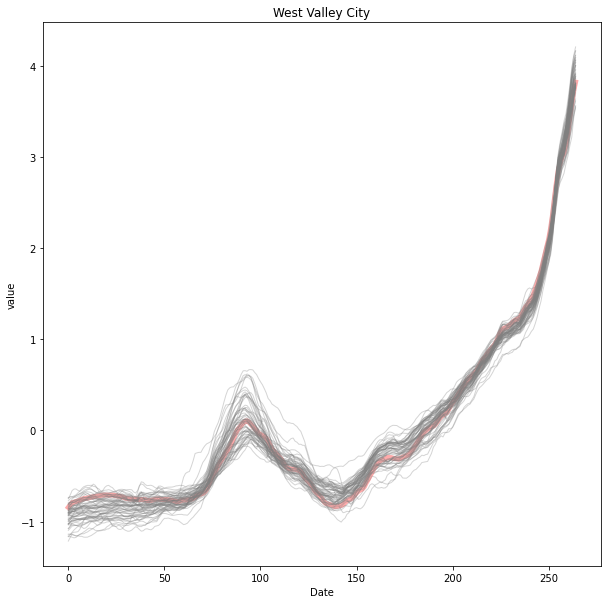

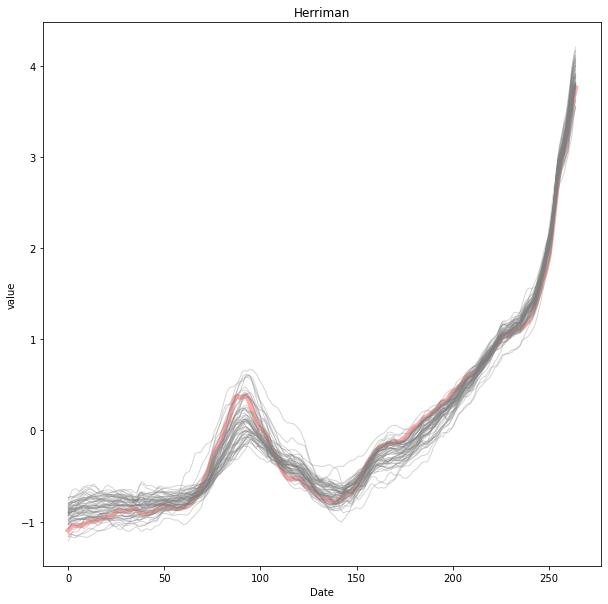

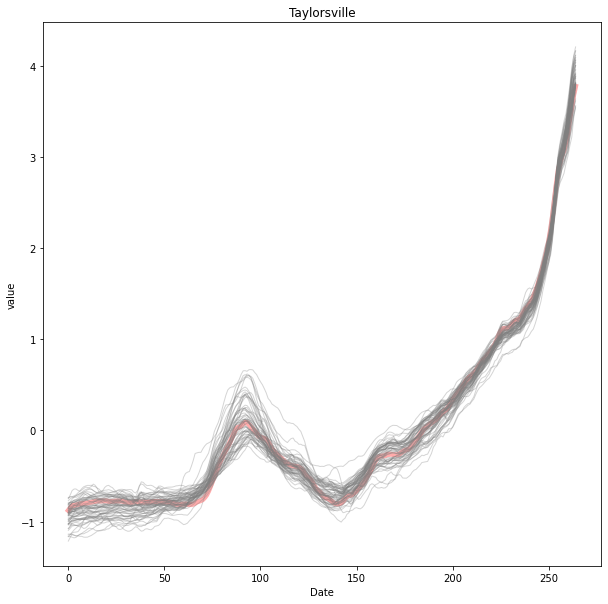

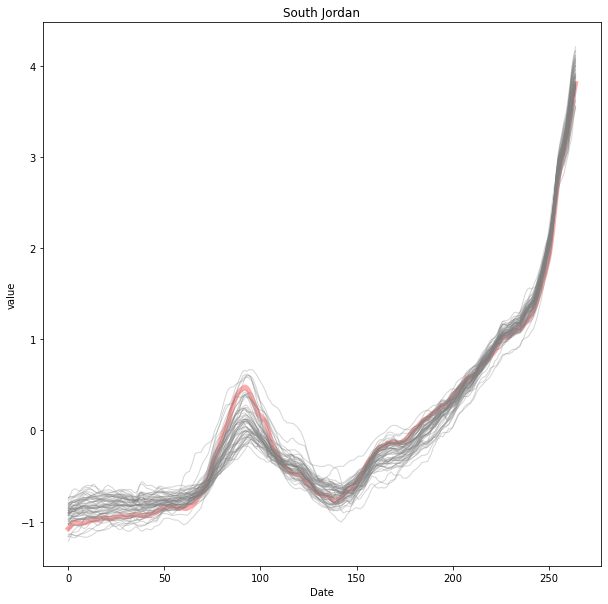

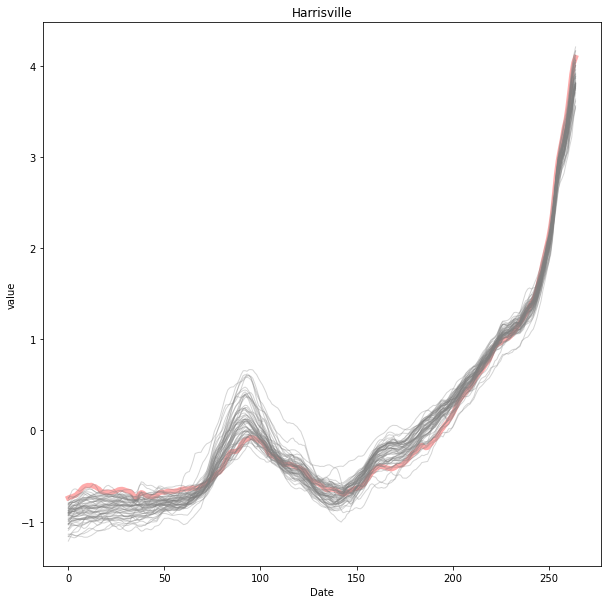

...

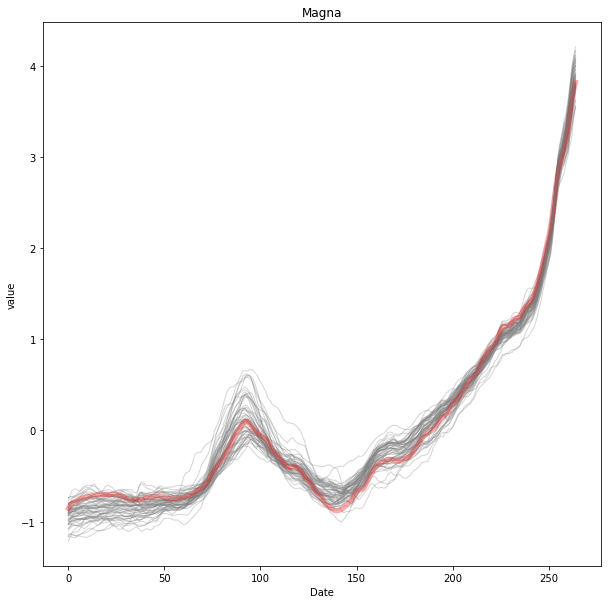

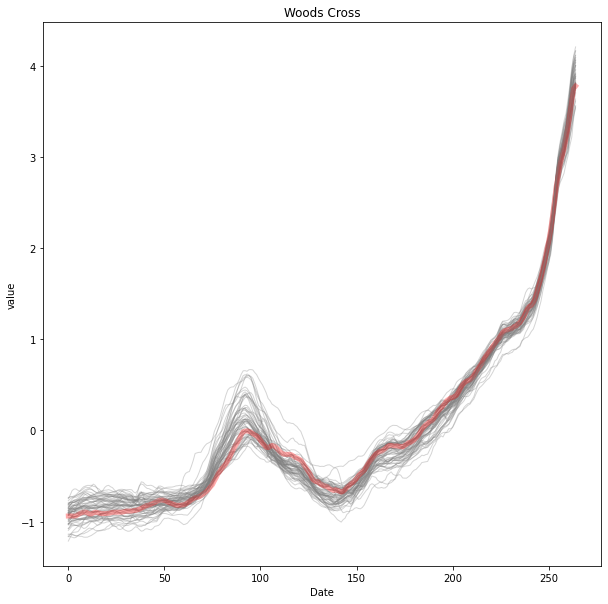

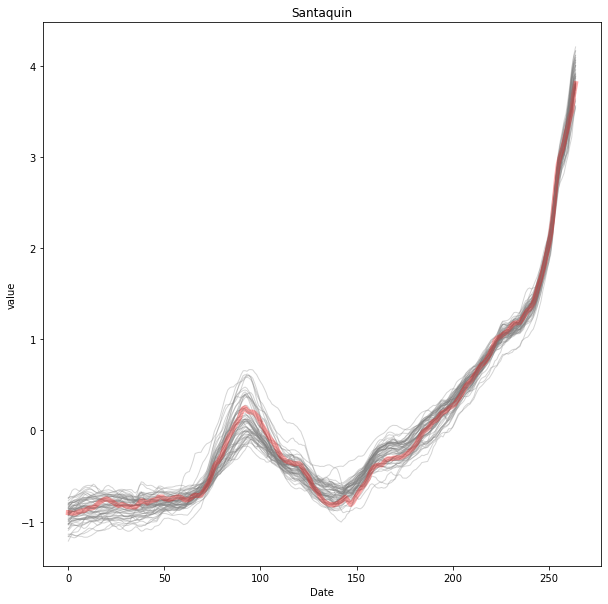

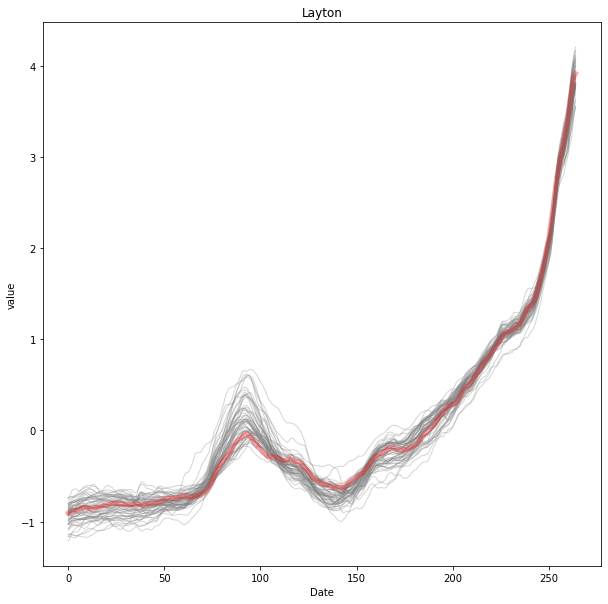

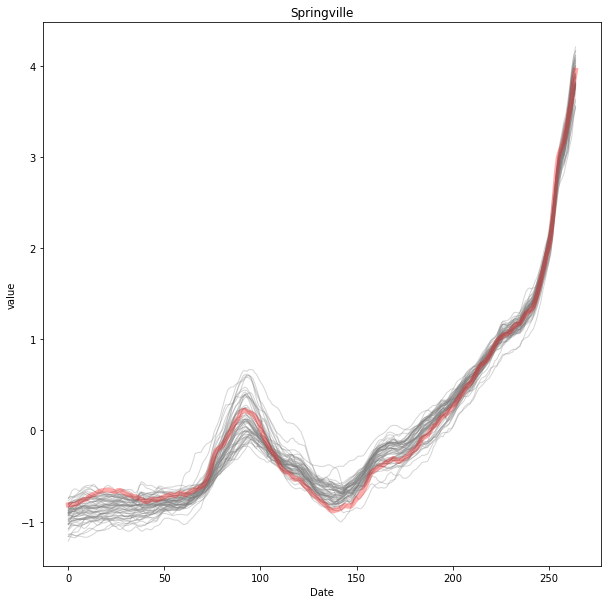

In [37]:
for city in melted2_df.variable.unique():
    palette = {c:'red' if c==city else 'grey' for c in melted2_df.variable.unique()}
    sizes = {c: 5 if c==city else 1 for c in melted2_df.variable.unique()}
    plt.figure(figsize=(10,10))
    ax = sns.lineplot(data = melted2_df, x = melted2_df.Date,  y = "value", hue = "variable", alpha = 0.33, palette = palette, size = "variable", sizes = sizes)
    ax.get_legend().remove()
    ax.set_title(label=city)
    plt.show()

In [38]:
x = sm.add_constant(main_df["Rate "])

In [39]:
x

,const,Rate
Date,,
2000-05,1.0,8.52
2000-06,1.0,8.29
2000-07,1.0,8.15
2000-08,1.0,8.03
2000-09,1.0,7.91
2000-10,1.0,7.80
2000-11,1.0,7.75
2000-12,1.0,7.38
2001-01,1.0,7.03


In [40]:
y = main_df['Salt Lake City']

In [41]:
y = pd.to_numeric(y)

In [42]:
model = sm.OLS(y, x, missing = 'drop')
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         Salt Lake City   R-squared:                       0.387
Model:                            OLS   Adj. R-squared:                  0.385
Method:                 Least Squares   F-statistic:                     165.9
Date:                Wed, 07 Sep 2022   Prob (F-statistic):           9.09e-30
Time:                        19:04:49   Log-Likelihood:                -3378.7
No. Observations:                 265   AIC:                             6761.
Df Residuals:                     263   BIC:                             6768.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        5.48e+05      2e+04     27.400      0.000    5.09e+05    5.87e+05
Rate       -5.046e+04   3916.809    -12.882      0.000   -5.82e+04   -4.27e+04
==============================================================================
Omnibus:                       78.445   Durbin-Watson:                   0.015
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              208.447
Skew:                           1.343   Prob(JB):                     5.45e-46
Kurtosis:                       6.415   Cond. No.                         20.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [43]:
salt_df = pd.concat([x, y], axis = 1)
salt_df = salt_df.dropna()
salt_df['Date'] = salt_df.index.to_timestamp()
salt_df

,const,Rate,Salt Lake City,Date
Date,,,,
2000-05,1.0,8.52,194805.0,2000-05-01
2000-06,1.0,8.29,196727.0,2000-06-01
2000-07,1.0,8.15,198735.0,2000-07-01
2000-08,1.0,8.03,198433.0,2000-08-01
2000-09,1.0,7.91,198839.0,2000-09-01
2000-10,1.0,7.80,199023.0,2000-10-01
2000-11,1.0,7.75,199409.0,2000-11-01
2000-12,1.0,7.38,199677.0,2000-12-01
2001-01,1.0,7.03,199802.0,2001-01-01


In [44]:
new_df = salt_df
new_df

,const,Rate,Salt Lake City,Date
Date,,,,
2000-05,1.0,8.52,194805.0,2000-05-01
2000-06,1.0,8.29,196727.0,2000-06-01
2000-07,1.0,8.15,198735.0,2000-07-01
2000-08,1.0,8.03,198433.0,2000-08-01
2000-09,1.0,7.91,198839.0,2000-09-01
2000-10,1.0,7.80,199023.0,2000-10-01
2000-11,1.0,7.75,199409.0,2000-11-01
2000-12,1.0,7.38,199677.0,2000-12-01
2001-01,1.0,7.03,199802.0,2001-01-01


<AxesSubplot:xlabel='Date', ylabel='Salt Lake City'>

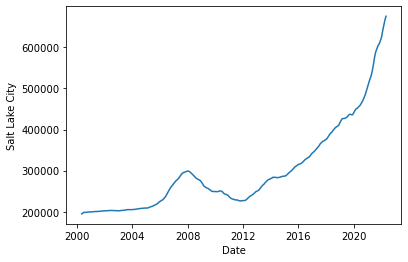

In [45]:

sns.lineplot(data = salt_df, x = salt_df.Date, y = 'Salt Lake City')

<AxesSubplot:xlabel='Date', ylabel='Rate '>

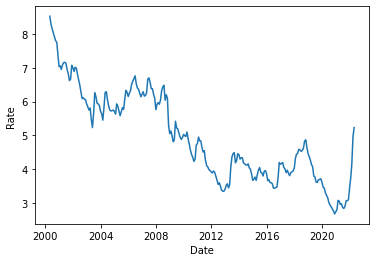

In [46]:
sns.lineplot(data = salt_df, x = salt_df.Date , y = 'Rate ')

In [47]:
salt_df = pd.concat([x, y], axis = 1)
salt_df = salt_df.diff().dropna()
salt_df.const = 1
salt_df['Date'] = salt_df.index.to_timestamp()
salt_df

,const,Rate,Salt Lake City,Date
Date,,,,
2000-06,1,-0.23,1922.0,2000-06-01
2000-07,1,-0.14,2008.0,2000-07-01
2000-08,1,-0.12,-302.0,2000-08-01
2000-09,1,-0.12,406.0,2000-09-01
2000-10,1,-0.11,184.0,2000-10-01
2000-11,1,-0.05,386.0,2000-11-01
2000-12,1,-0.37,268.0,2000-12-01
2001-01,1,-0.35,125.0,2001-01-01
2001-02,1,0.02,73.0,2001-02-01


In [48]:
salt_df.info()

<class 'pandas.core.frame.DataFrame'>
PeriodIndex: 264 entries, 2000-06 to 2022-05
Freq: M
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   const           264 non-null    int64         
 1   Rate            264 non-null    float64       
 2   Salt Lake City  264 non-null    float64       
 3   Date            264 non-null    datetime64[ns]
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 10.3 KB


<AxesSubplot:xlabel='Date', ylabel='Salt Lake City'>

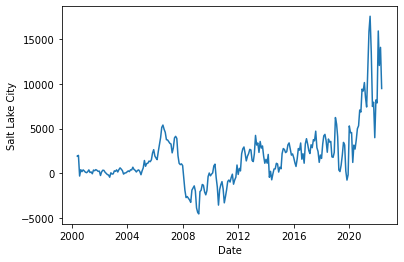

In [49]:
sns.lineplot(data = salt_df, x = salt_df.Date, y = 'Salt Lake City')

<AxesSubplot:xlabel='Date', ylabel='Rate '>

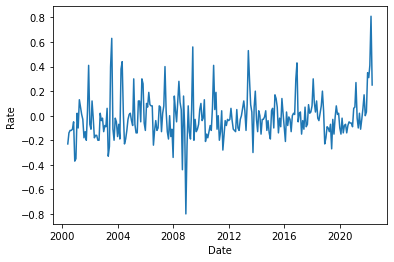

In [50]:
sns.lineplot(data = salt_df, x = salt_df.Date , y = 'Rate ')

In [51]:
x = sm.add_constant(salt_df["Rate "])
y = salt_df['Salt Lake City']

In [52]:
model = sm.OLS.from_formula(formula = 'y ~ x', data = salt_df)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.048
Model:                            OLS   Adj. R-squared:                  0.044
Method:                 Least Squares   F-statistic:                     13.21
Date:                Wed, 07 Sep 2022   Prob (F-statistic):           0.000335
Time:                        19:04:49   Log-Likelihood:                -2500.4
No. Observations:                 264   AIC:                             5005.
Df Residuals:                     262   BIC:                             5012.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    935.3087     97.280      9.615      0.000     743.759    1126.859
x[0]         935.3087     97.280      9.615      0.000     743.759    1126.859
x[1]        4000.9158   1100.858      3.634      0.000    1833.260    6168.571
==============================================================================
Omnibus:                      105.608   Durbin-Watson:                   0.251
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              414.488
Skew:                           1.660   Prob(JB):                     9.89e-91
Kurtosis:                       8.163   Cond. No.                     2.94e+18
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 6.12e-35. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [53]:
salt_df

,const,Rate,Salt Lake City,Date
Date,,,,
2000-06,1,-0.23,1922.0,2000-06-01
2000-07,1,-0.14,2008.0,2000-07-01
2000-08,1,-0.12,-302.0,2000-08-01
2000-09,1,-0.12,406.0,2000-09-01
2000-10,1,-0.11,184.0,2000-10-01
2000-11,1,-0.05,386.0,2000-11-01
2000-12,1,-0.37,268.0,2000-12-01
2001-01,1,-0.35,125.0,2001-01-01
2001-02,1,0.02,73.0,2001-02-01


In [54]:
salt_df.index = pd.period_range('2000-06', '2022-05', freq='M')

In [55]:
salt_df.index

PeriodIndex(['2000-06', '2000-07', '2000-08', '2000-09', '2000-10', '2000-11',
             '2000-12', '2001-01', '2001-02', '2001-03',
             ...
             '2021-08', '2021-09', '2021-10', '2021-11', '2021-12', '2022-01',
             '2022-02', '2022-03', '2022-04', '2022-05'],
            dtype='period[M]', length=264)

In [56]:
response = y 

In [57]:
predictors = x 

In [99]:
auto = pm.auto_arima(y=response, exogenous=predictors, suppress_warnings=False,
stationary=True, maxiter=1000)
auto.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  264
Model:               SARIMAX(5, 0, 1)   Log Likelihood               -2211.059
Date:                Wed, 07 Sep 2022   AIC                           4436.118
Time:                        19:34:44   BIC                           4461.150
Sample:                    06-30-2000   HQIC                          4446.176
                         - 05-31-2022                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2443      0.158      1.550      0.121      -0.065       0.553
ar.L2          0.8826      0.140      6.311      0.000       0.609       1.157
ar.L3         -0.6501      0.053    -12.223      0.000      -0.754      -0.546
ar.L4         -0.0519      0.107     -0.486      0.627      -0.261       0.157
ar.L5          0.5570      0.085      6.531      0.000       0.390       0.724
ma.L1          0.6942      0.165      4.213      0.000       0.371       1.017
sigma2      1.116e+06   6.26e+04     17.816      0.000    9.93e+05    1.24e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.79   Jarque-Bera (JB):               514.52
Prob(Q):                              0.37   Prob(JB):                         0.00
Heteroskedasticity (H):              10.24   Skew:                             0.50
Prob(H) (two-sided):                  0.00   Kurtosis:                         9.77
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [193]:
new_df = new_df.astype({'Rate ': 'int'})

In [194]:
new_df = new_df.astype({'Salt Lake City': 'int'})

In [215]:
new_df.describe()

,Rate,Salt Lake City
count,265.000000,265.000000
mean,4.422642,299035.637736
std,1.390803,106639.738964
min,2.000000,194805.000000
25%,3.000000,220789.000000
50%,4.000000,266809.000000
75%,6.000000,335656.000000
max,8.000000,675485.000000


In [217]:
master1.describe()

,Mean-Value,Mean-Rate,M2V,GDP
count,89.000000,89.000000,89.000000,89.000000
mean,300041.035581,4.948727,1.680966,16148.148652
std,109206.978344,1.325500,0.289456,3833.295515
min,195766.000000,2.760000,1.103000,10247.720000
25%,220913.333333,3.886667,1.458000,13324.204000
50%,267062.000000,4.663333,1.709000,15557.535000
75%,335848.666667,6.076667,1.953000,18968.041000
max,670746.500000,8.405000,2.151000,24882.878000


ValueError: x is required to have ndim 1 but has ndim 2

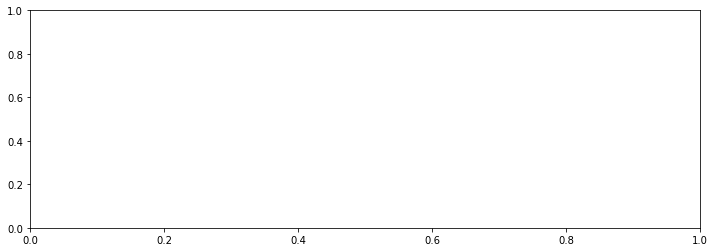

In [211]:
def autocorrelation_plot(master):
    from statsmodels.graphics.tsaplots import plot_acf
    fig = plt.figure(figsize=(12, 4))
    ax1 = fig.gca()
    plot_acf(new_df, lags=20, ax=ax1)
    plt.show()
    
autocorrelation_plot(result)

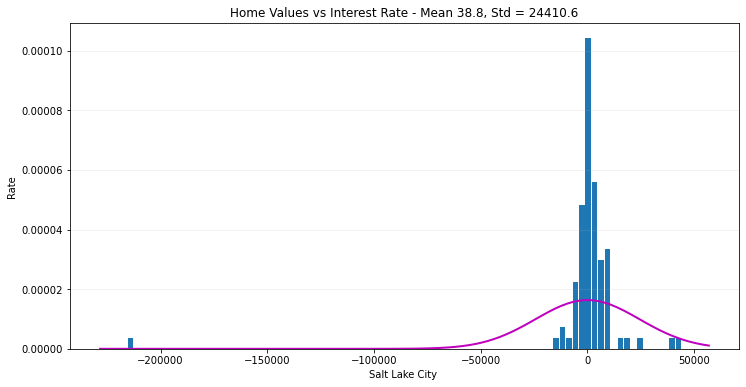

In [218]:
def resid_histogram(data):
    from numpy import linspace
    from scipy.stats import norm
    plt.figure(figsize=(12, 6))
    plt.hist(data, bins = 'auto', density = True, rwidth = 0.85, label = 'Home Value')
    mean_new_df, std_new_df = norm.fit(data)
    xmin, xmax = plt.xlim()
    curve_length = linspace(xmin, xmax, 100)
    bell_curve = norm.pdf(curve_length, mean_new_df, std_new_df)
    plt.plot(curve_length, bell_curve, 'm', linewidth = 2)
    plt.grid(axis='y', alpha = 0.2)
    plt.xlabel('Salt Lake City ')
    plt.ylabel('Rate')
    plt.title(f'Home Values vs Interest Rate - Mean {round(mean_new_df, 1)}, Std = {round(std_new_df, 1)}')
    plt.show()
    
resid_histogram(result.resid)

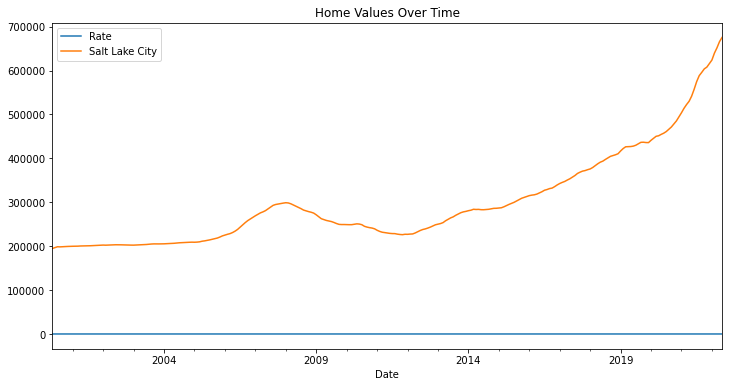

In [201]:
def residuals_over_time(data):
    fig = plt.figure(figsize=(12, 6))
    ax1 = fig.gca()
    
    new_df.plot.line(ax=ax1)
    plt.title('Home Values Over Time')
    plt.show()
    
residuals_over_time(result)

TypeError: 'SARIMAXResultsWrapper' object is not subscriptable

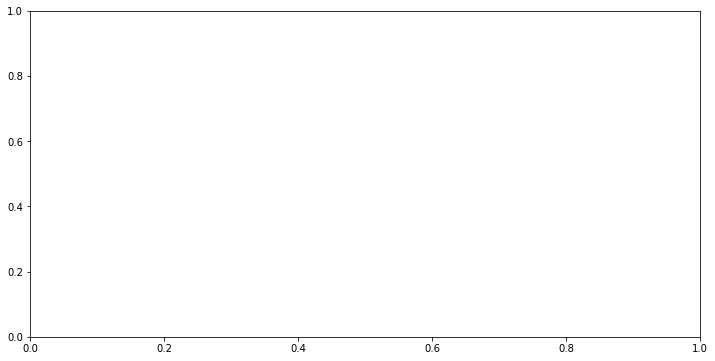

In [207]:
def residuals(new_df):
    fig = plt.figure(figsize=(12, 6))
    ax1 = fig.gca()
    sns.scatterplot(x=new_df['Rate'] , y=new_df['Salt Lake City'], ax=ax1)
    plt.title('Home Value vs Interest Rate')
    plt.ylabel('Rate')
    plt.xlabel('Salt Lake City')
    plt.show()
    
residuals(result)

In [98]:
import warnings
warnings.filterwarnings('ignore')

In [59]:
model = sm.tsa.SARIMAX(endog=response, exog1=predictors, trend='c', order=(1, 0,1))
result = model.fit(maxiter=1000, disp=0)
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:         Salt Lake City   No. Observations:                  264
Model:               SARIMAX(1, 0, 1)   Log Likelihood               -2271.351
Date:                Wed, 07 Sep 2022   AIC                           4550.702
Time:                        19:04:53   BIC                           4565.006
Sample:                    06-30-2000   HQIC                          4556.450
                         - 05-31-2022                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    171.2516    129.333      1.324      0.185     -82.236     424.739
ar.L1          0.9226      0.017     54.819      0.000       0.890       0.956
ma.L1         -0.0260      0.042     -0.619      0.536      -0.108       0.056
sigma2      1.733e+06   7.01e+04     24.724      0.000     1.6e+06    1.87e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):              1026.82
Prob(Q):                              0.99   Prob(JB):                         0.00
Heteroskedasticity (H):              16.27   Skew:                             1.32
Prob(H) (two-sided):                  0.00   Kurtosis:                        12.30
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [213]:
new_df = new_df.drop(columns = ['Date', 'const'])
new_df

KeyError: "['Date', 'const'] not found in axis"

In [61]:
data = { 
    'Date': [], 
    'Mean-Value': [],
    'Mean-Rate': []
}

for year in range(2000, 2023):
    q1 = new_df.loc[f'{year}-01':f'{year}-03']
    data['Date'].append(f'{year}-01-01') 
    data['Mean-Value'].append(q1['Salt Lake City'].mean())
    data['Mean-Rate'].append(q1['Rate '].mean())
    
    q2 = new_df.loc[f'{year}-04':f'{year}-06']
    data['Date'].append(f'{year}-04-01') 
    data['Mean-Value'].append(q2['Salt Lake City'].mean())
    data['Mean-Rate'].append(q2['Rate '].mean())
    
    q3 = new_df.loc[f'{year}-07':f'{year}-09']
    data['Date'].append(f'{year}-07-01') 
    data['Mean-Value'].append(q3['Salt Lake City'].mean())
    data['Mean-Rate'].append(q3['Rate '].mean())
    
    q4 = new_df.loc[f'{year}-10':f'{year}-12']
    data['Date'].append(f'{year}-10-01') 
    data['Mean-Value'].append(q4['Salt Lake City'].mean())
    data['Mean-Rate'].append(q4['Rate '].mean())
    
final_df = pd.DataFrame(data)    
final_df = final_df.dropna()
final_df

,Date,Mean-Value,Mean-Rate
1,2000-04-01,195766.000000,8.405000
2,2000-07-01,198669.000000,8.030000
3,2000-10-01,199369.666667,7.643333
4,2001-01-01,199910.666667,7.010000
5,2001-04-01,200555.666667,7.130000
6,2001-07-01,200984.333333,6.966667
7,2001-10-01,202011.666667,6.783333
8,2002-01-01,202408.666667,6.966667
9,2002-04-01,203035.333333,6.816667
10,2002-07-01,203077.000000,6.290000


In [62]:
velocity_df = pd.read_csv("/Users/jacksonjerman/Desktop/data/week7/M2V (1).csv")

In [63]:
velocity_df

,DATE,M2V
0,1959-01-01,1.773
1,1959-04-01,1.789
2,1959-07-01,1.773
3,1959-10-01,1.779
4,1960-01-01,1.817
5,1960-04-01,1.797
6,1960-07-01,1.780
7,1960-10-01,1.737
8,1961-01-01,1.723
9,1961-04-01,1.725


In [64]:
vel_df= velocity_df.rename(columns = {'DATE': 'Date'})
vel_df

,Date,M2V
0,1959-01-01,1.773
1,1959-04-01,1.789
2,1959-07-01,1.773
3,1959-10-01,1.779
4,1960-01-01,1.817
5,1960-04-01,1.797
6,1960-07-01,1.780
7,1960-10-01,1.737
8,1961-01-01,1.723
9,1961-04-01,1.725


In [65]:
master = final_df.merge(vel_df, on = "Date", how = "outer")
master = master.dropna()
master

,Date,Mean-Value,Mean-Rate,M2V
0,2000-04-01,195766.000000,8.405000,2.151
1,2000-07-01,198669.000000,8.030000,2.141
2,2000-10-01,199369.666667,7.643333,2.133
3,2001-01-01,199910.666667,7.010000,2.085
4,2001-04-01,200555.666667,7.130000,2.059
5,2001-07-01,200984.333333,6.966667,2.014
6,2001-10-01,202011.666667,6.783333,1.980
7,2002-01-01,202408.666667,6.966667,1.969
8,2002-04-01,203035.333333,6.816667,1.972
9,2002-07-01,203077.000000,6.290000,1.953


In [66]:
m = master[['Mean-Value']]

In [67]:
b = master[['Mean-Rate', 'M2V']]

In [68]:
response1 = m

In [69]:
predictors1 = b

In [70]:
auto = pm.auto_arima(y=response1, exogenous=predictors1, suppress_warnings=False,
stationary=True, maxiter=1000)
auto.summary()

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: exogenous. After release 0.14, this will raise.
  warnings.warn(
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_gra

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:1906: RuntimeWarning: invalid value encountered in reciprocal
  return np.roots(self.polynomial_reduced_ma)**-1
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: exogenous. After release 0.14, this will raise.
  warnings.warn(
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   89
Model:               SARIMAX(2, 0, 1)   Log Likelihood                -869.851
Date:                Wed, 07 Sep 2022   AIC                           1749.702
Time:                        19:04:56   BIC                           1762.145
Sample:                             0   HQIC                          1754.718
                                 - 89                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    643.9361   1223.231      0.526      0.599   -1753.553    3041.425
ar.L1          1.9667      0.035     56.918      0.000       1.899       2.034
ar.L2         -0.9679      0.035    -27.675      0.000      -1.036      -0.899
ma.L1         -0.1567      0.094     -1.663      0.096      -0.341       0.028
sigma2      1.587e+07      0.056   2.83e+08      0.000    1.59e+07    1.59e+07
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):                84.99
Prob(Q):                              0.86   Prob(JB):                         0.00
Heteroskedasticity (H):              10.36   Skew:                            -0.12
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.78
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.12e+24. Standard errors may be unstable.
"""

In [71]:
model = sm.tsa.SARIMAX(endog=response1, exog2=predictors1, trend='c', order=(1, 0,1))
result = model.fit(maxiter=1000, disp=0)
result.summary()

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:             Mean-Value   No. Observations:                   89
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -937.744
Date:                Wed, 07 Sep 2022   AIC                           1883.488
Time:                        19:04:56   BIC                           1893.442
Sample:                             0   HQIC                          1887.500
                                 - 89                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   1252.2725   8545.985      0.147      0.884   -1.55e+04     1.8e+04
ar.L1          0.9970      0.021     48.472      0.000       0.957       1.037
ma.L1          1.0000      0.100     10.040      0.000       0.805       1.195
sigma2      7.342e+07   3.14e-07   2.34e+14      0.000    7.34e+07    7.34e+07
===================================================================================
Ljung-Box (L1) (Q):                  11.19   Jarque-Bera (JB):               419.03
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):              17.86   Skew:                             2.42
Prob(H) (two-sided):                  0.00   Kurtosis:                        12.47
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.86e+36. Standard errors may be unstable.
"""

In [72]:
model = sm.OLS(m, b, missing = 'drop')
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:             Mean-Value   R-squared (uncentered):                   0.786
Model:                            OLS   Adj. R-squared (uncentered):              0.781
Method:                 Least Squares   F-statistic:                              159.6
Date:                Wed, 07 Sep 2022   Prob (F-statistic):                    7.80e-30
Time:                        19:04:56   Log-Likelihood:                         -1185.6
No. Observations:                  89   AIC:                                      2375.
Df Residuals:                      87   BIC:                                      2380.
Df Model:                           2                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Mean-Rate  -5.882e+04    2.4e+04     -2.448      0.016   -1.07e+05   -1.11e+04
M2V         3.395e+05   7.22e+04      4.704      0.000    1.96e+05    4.83e+05
==============================================================================
Omnibus:                       34.782   Durbin-Watson:                   0.026
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               60.959
Skew:                           1.623   Prob(JB):                     5.79e-14
Kurtosis:                       5.431   Cond. No.                         25.9
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [73]:
model = sm.OLS.from_formula(formula = 'm ~ b', data = master)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      m   R-squared:                       0.852
Model:                            OLS   Adj. R-squared:                  0.849
Method:                 Least Squares   F-statistic:                     247.9
Date:                Wed, 07 Sep 2022   Prob (F-statistic):           1.98e-36
Time:                        19:04:56   Log-Likelihood:                -1073.2
No. Observations:                  89   AIC:                             2152.
Df Residuals:                      86   BIC:                             2160.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   9.781e+05   3.11e+04     31.467      0.000    9.16e+05    1.04e+06
b[0]        6.981e+04   7961.791      8.768      0.000     5.4e+04    8.56e+04
b[1]       -6.089e+05   3.65e+04    -16.702      0.000   -6.81e+05   -5.36e+05
==============================================================================
Omnibus:                        6.544   Durbin-Watson:                   0.370
Prob(Omnibus):                  0.038   Jarque-Bera (JB):                6.446
Skew:                           0.611   Prob(JB):                       0.0398
Kurtosis:                       2.504   Cond. No.                         56.3
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [74]:
GDP_df = pd.read_csv("/Users/jacksonjerman/Desktop/data/week7/GDP.csv")

In [75]:
gdp_df= GDP_df.rename(columns = {'DATE': 'Date'})
gdp_df

,Date,GDP
0,1947-01-01,243.164
1,1947-04-01,245.968
2,1947-07-01,249.585
3,1947-10-01,259.745
4,1948-01-01,265.742
...,...,...
297,2021-04-01,22740.959
298,2021-07-01,23202.344
299,2021-10-01,24002.815
300,2022-01-01,24386.734


In [76]:
master1 = master.merge(gdp_df, on = "Date", how = "outer")
master1 = master1.dropna()
master1

,Date,Mean-Value,Mean-Rate,M2V,GDP
0,2000-04-01,195766.000000,8.405000,2.151,10247.720
1,2000-07-01,198669.000000,8.030000,2.141,10318.165
2,2000-10-01,199369.666667,7.643333,2.133,10435.744
3,2001-01-01,199910.666667,7.010000,2.085,10470.231
4,2001-04-01,200555.666667,7.130000,2.059,10599.000
5,2001-07-01,200984.333333,6.966667,2.014,10598.020
6,2001-10-01,202011.666667,6.783333,1.980,10660.465
7,2002-01-01,202408.666667,6.966667,1.969,10783.500
8,2002-04-01,203035.333333,6.816667,1.972,10887.460
9,2002-07-01,203077.000000,6.290000,1.953,10984.040


In [77]:
s = master1[['Mean-Rate', 'M2V', 'GDP']]

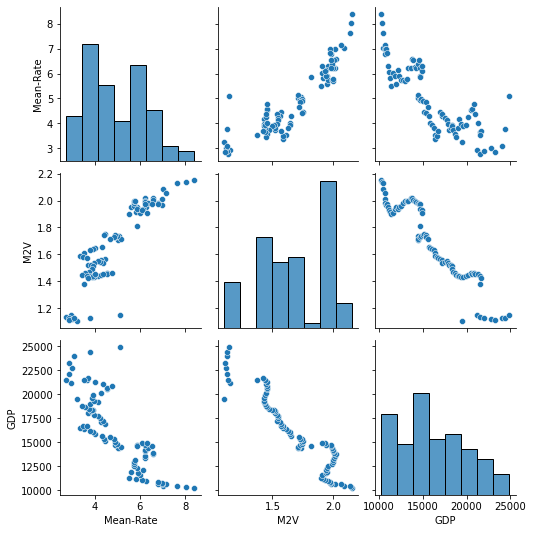

In [101]:
sns.pairplot(s)

In [102]:
s.corr()

,Mean-Rate,M2V,GDP
Mean-Rate,1.000000,0.903306,-0.827578
M2V,0.903306,1.000000,-0.940194
GDP,-0.827578,-0.940194,1.000000


In [78]:
predictors2 = s

In [100]:
auto = pm.auto_arima(y=response1, exogenous=predictors2, suppress_warnings=False,
stationary=True, maxiter=1000)
auto.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   89
Model:               SARIMAX(2, 0, 1)   Log Likelihood                -869.851
Date:                Thu, 08 Sep 2022   AIC                           1749.702
Time:                        10:37:05   BIC                           1762.145
Sample:                             0   HQIC                          1754.718
                                 - 89                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    643.9361   1223.231      0.526      0.599   -1753.553    3041.425
ar.L1          1.9667      0.035     56.918      0.000       1.899       2.034
ar.L2         -0.9679      0.035    -27.675      0.000      -1.036      -0.899
ma.L1         -0.1567      0.094     -1.663      0.096      -0.341       0.028
sigma2      1.587e+07      0.056   2.83e+08      0.000    1.59e+07    1.59e+07
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):                84.99
Prob(Q):                              0.86   Prob(JB):                         0.00
Heteroskedasticity (H):              10.36   Skew:                            -0.12
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.78
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.12e+24. Standard errors may be unstable.
"""

In [80]:
model = sm.tsa.SARIMAX(endog=response1, exog3=predictors2, trend='c', order=(1, 0,1))
result = model.fit(maxiter=1000, disp=0)
result.summary()

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:             Mean-Value   No. Observations:                   89
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -937.744
Date:                Wed, 07 Sep 2022   AIC                           1883.488
Time:                        19:04:59   BIC                           1893.442
Sample:                             0   HQIC                          1887.500
                                 - 89                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   1252.2725   8545.985      0.147      0.884   -1.55e+04     1.8e+04
ar.L1          0.9970      0.021     48.472      0.000       0.957       1.037
ma.L1          1.0000      0.100     10.040      0.000       0.805       1.195
sigma2      7.342e+07   3.14e-07   2.34e+14      0.000    7.34e+07    7.34e+07
===================================================================================
Ljung-Box (L1) (Q):                  11.19   Jarque-Bera (JB):               419.03
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):              17.86   Skew:                             2.42
Prob(H) (two-sided):                  0.00   Kurtosis:                        12.47
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.86e+36. Standard errors may be unstable.
"""

In [81]:
model = sm.OLS(m, s, missing = 'drop')
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:             Mean-Value   R-squared (uncentered):                   0.991
Model:                            OLS   Adj. R-squared (uncentered):              0.991
Method:                 Least Squares   F-statistic:                              3254.
Date:                Wed, 07 Sep 2022   Prob (F-statistic):                    2.20e-88
Time:                        19:04:59   Log-Likelihood:                         -1043.2
No. Observations:                  89   AIC:                                      2092.
Df Residuals:                      86   BIC:                                      2100.
Df Model:                           3                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Mean-Rate   6.026e+04   5551.932     10.854      0.000    4.92e+04    7.13e+04
M2V        -2.463e+05   1.96e+04    -12.565      0.000   -2.85e+05   -2.07e+05
GDP           25.7481      0.572     44.982      0.000      24.610      26.886
==============================================================================
Omnibus:                        3.292   Durbin-Watson:                   0.320
Prob(Omnibus):                  0.193   Jarque-Bera (JB):                2.782
Skew:                           0.427   Prob(JB):                        0.249
Kurtosis:                       3.146   Cond. No.                     1.05e+05
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.05e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [82]:
model = sm.OLS.from_formula(formula = 'm ~ s', data = master1)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      m   R-squared:                       0.926
Model:                            OLS   Adj. R-squared:                  0.923
Method:                 Least Squares   F-statistic:                     353.3
Date:                Wed, 07 Sep 2022   Prob (F-statistic):           7.20e-48
Time:                        19:04:59   Log-Likelihood:                -1042.6
No. Observations:                  89   AIC:                             2093.
Df Residuals:                      85   BIC:                             2103.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    1.12e+05    9.7e+04      1.155      0.251   -8.08e+04    3.05e+05
s[0]        6.199e+04   5739.583     10.800      0.000    5.06e+04    7.34e+04
s[1]        -2.91e+05   4.33e+04     -6.718      0.000   -3.77e+05   -2.05e+05
s[2]          22.9378      2.499      9.177      0.000      17.968      27.907
==============================================================================
Omnibus:                        2.890   Durbin-Watson:                   0.335
Prob(Omnibus):                  0.236   Jarque-Bera (JB):                2.458
Skew:                           0.405   Prob(JB):                        0.293
Kurtosis:                       3.088   Cond. No.                     5.41e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.41e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [83]:
fed_df = pd.read_csv("/Users/jacksonjerman/Desktop/data/week7/WALCL.csv")

In [84]:
fed1_df= fed_df.rename(columns = {'DATE': 'Date'})
fed1_df

,Date,WALCL
0,2003-01-01,723346.230769230769
1,2003-04-01,737916.230769230769
2,2003-07-01,741690.307692307692
3,2003-10-01,751828.214285714286
4,2004-01-01,756309.230769230769
5,2004-04-01,765641.000000000000
6,2004-07-01,778478.307692307692
7,2004-10-01,799498.769230769231
8,2005-01-01,803304.923076923077
9,2005-04-01,807718.153846153846


In [85]:
master2 = master1.merge(fed1_df, on = "Date", how = "outer")
master2 = master2.dropna()
master2

,Date,Mean-Value,Mean-Rate,M2V,GDP,WALCL
11,2003-01-01,202647.000000,5.836667,1.915,11174.129,723346.230769230769
12,2003-04-01,203518.333333,5.506667,1.901,11312.766,737916.230769230769
13,2003-07-01,204868.000000,6.013333,1.905,11566.669,741690.307692307692
14,2003-10-01,205175.666667,5.920000,1.940,11772.234,751828.214285714286
15,2004-01-01,205630.000000,5.600000,1.950,11923.447,756309.230769230769
16,2004-04-01,206723.333333,6.130000,1.940,12112.815,765641.000000000000
17,2004-07-01,208014.666667,5.893333,1.949,12305.307,778478.307692307692
18,2004-10-01,208871.666667,5.733333,1.958,12527.214,799498.769230769231
19,2005-01-01,209383.000000,5.756667,1.985,12767.286,803304.923076923077
20,2005-04-01,212212.000000,5.720000,1.995,12922.656,807718.153846153846


In [86]:
w = master2[['Mean-Rate', 'M2V', 'GDP', 'WALCL']]

In [87]:
predictors3 = w

In [88]:
auto = pm.auto_arima(y=response1, exogenous=predictors3, suppress_warnings=False,
stationary=True, maxiter=1000)
auto.summary()

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: exogenous. After release 0.14, this will raise.
  warnings.warn(
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_gra

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:1906: RuntimeWarning: invalid value encountered in reciprocal
  return np.roots(self.polynomial_reduced_ma)**-1
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: exogenous. After release 0.14, this will raise.
  warnings.warn(
/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   89
Model:               SARIMAX(2, 0, 1)   Log Likelihood                -869.851
Date:                Wed, 07 Sep 2022   AIC                           1749.702
Time:                        19:05:02   BIC                           1762.145
Sample:                             0   HQIC                          1754.718
                                 - 89                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    643.9361   1223.231      0.526      0.599   -1753.553    3041.425
ar.L1          1.9667      0.035     56.918      0.000       1.899       2.034
ar.L2         -0.9679      0.035    -27.675      0.000      -1.036      -0.899
ma.L1         -0.1567      0.094     -1.663      0.096      -0.341       0.028
sigma2      1.587e+07      0.056   2.83e+08      0.000    1.59e+07    1.59e+07
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):                84.99
Prob(Q):                              0.86   Prob(JB):                         0.00
Heteroskedasticity (H):              10.36   Skew:                            -0.12
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.78
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.12e+24. Standard errors may be unstable.
"""

In [89]:
model = sm.tsa.SARIMAX(endog=response1, exog4=predictors3, trend='c', order=(1, 0,1))
result = model.fit(maxiter=1000, disp=0)
result.summary()

/Users/jacksonjerman/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:             Mean-Value   No. Observations:                   89
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -937.744
Date:                Wed, 07 Sep 2022   AIC                           1883.488
Time:                        19:05:02   BIC                           1893.442
Sample:                             0   HQIC                          1887.500
                                 - 89                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   1252.2725   8545.985      0.147      0.884   -1.55e+04     1.8e+04
ar.L1          0.9970      0.021     48.472      0.000       0.957       1.037
ma.L1          1.0000      0.100     10.040      0.000       0.805       1.195
sigma2      7.342e+07   3.14e-07   2.34e+14      0.000    7.34e+07    7.34e+07
===================================================================================
Ljung-Box (L1) (Q):                  11.19   Jarque-Bera (JB):               419.03
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):              17.86   Skew:                             2.42
Prob(H) (two-sided):                  0.00   Kurtosis:                        12.47
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.86e+36. Standard errors may be unstable.
"""

In [92]:
#model = sm.OLS(m, w, missing = 'drop')
#result = model.fit()
#result.summary()

In [93]:
#model = sm.OLS.from_formula(formula = 'm ~ w', data = master2)
#result = model.fit()
#result.summary()